<img src="https://dellaert.github.io/19F-4476/images/proj3/epipole_iphone.png" width="500"/>

<center>Epipolar lines showing camera locations given corresponding points in two views of a scene.<center> 

# PS 2: Projection Matrix and Fundamental Matrix Estimation with RANSAC

In this problem set, we will cover the following main topics:
1. Projection Matrix
2. Fundamental Matrix   
3. Fundamental Matrix with RANSAC 


## Setup

In [1]:
%matplotlib inline
%load_ext autoreload
%autoreload 2
import cv2
import numpy as np
import matplotlib.pyplot as plt
from proj2_code.utils import *

In [2]:
np.set_printoptions(suppress=True) # Suppresses printing in scientific notation

## Notations
* $w$ denotes the world, $c$ denotes the camera
* The superscript on the left denotes the coordinate system of the variable:
    * ${}^w \mathbf{X}$ is the coordinates of point $X$ in the world coordinate system
* The subscript on the right denotes the object or index
    * ${}^w \mathbf{R}_c$ is the rotation for camera $c$ in the world coordinate system
    * ${}^w \mathbf{X}_i$ denotes the coordinates of the $i$th point

# Part 1 Projection Matrix Estimation

**Learning Objective**: (1) Understanding the the camera projection matrix and (2) estimating it using fiducial objects for camera projection matrix estimation and pose estimation.

**Introduction**

In this first part you will perform pose estimation in an image taken by an uncalibrated camera. As we saw in class, pose estimation is incredibly useful; it is used in VR, AR, controller tracking, autonomous driving, and even satellite docking. Recall that for a pinhole camera model, the camera matrix $P∈\mathbb{R}^{3×4}$ is a projective mapping from world (3D) to pixel (2D) coordinates *defined up to a scale*.

\begin{align}
\mathbf{x} & \cong f({}^w \mathbf{X};\mathbf{P}) = \mathbf{P} \ ^{w} \mathbf{X} \\
\implies
\begin{bmatrix}
    u \\
    v \\
    1
\end{bmatrix}
&\cong
\begin{bmatrix}
    s \cdot u \\
    s \cdot v \\
    s
\end{bmatrix}
=
\begin{bmatrix}
p_{11} & p_{12} & p_{13} & p_{14} \\
p_{21} & p_{22} & p_{23} & p_{24} \\
p_{31} & p_{32} & p_{33} & p_{34} \\
\end{bmatrix}
\begin{bmatrix}
    {}^w X \\
    {}^w Y \\
    {}^w Z \\
    1
\end{bmatrix}
\end{align}

Above s is an arbitrary scale factor. The projection matrix can also be decomposed into intrinsic parameters $\mathbf{K}$ and extrinsic parameters ${}^w\mathbf{R}_c ^T\left[\mathbf{I}\mid -{}^w\mathbf{t}_c  \right]$.

\begin{align}
\mathbf{P} &= \mathbf{K}\ {}^w\mathbf{R}_c ^T\left[\mathbf{I}\mid -{}^w\mathbf{t}_c  \right] \\
\mathbf
{P} &=
\begin{bmatrix}
    \alpha & s & u_0 \\
    0 & \beta & v_0 \\
    0 & 0 & 1
\end{bmatrix}
\begin{bmatrix}
r_{11} & r_{21} & r_{31} \\
r_{12} & r_{22} & r_{32} \\
r_{13} & r_{23} & r_{33}
\end{bmatrix}
\begin{bmatrix}
1 & 0 & 0 & -t_x \\
0 & 1 & 0 & -t_y \\
0 & 0 & 1 & -t_z
\end{bmatrix}
\end{align}

Let’s look more carefully into what each of the individual parts of the decomposed matrix mean. The homogenous vector coordinates $({}^w X, {}^w Y, {}^w Z,1)$ of ${}^w \mathbf{X}$ indicate the position of a point in 3D space in the world coordinate system. The matrix $\left[\mathbf{I}\mid -{}^w\mathbf{t}_c  \right]$ represents a translation and the matrix ${}^w \mathbf{R}^T_c$ represents a rotation. When combined they convert points from the world to the camera coordinate system. An intuitive way to understand this is to think about how aligning the axes of the world coordinate system to the ones of the camera coordinate system can be done with a rotation and a translation.

<img src="https://dellaert.github.io/19F-4476/images/proj3/coordiante_systems.png" width="500"/>
<center>The distinction between camera coordinate and world coordinate systems is a rotation and a translation.</center>

**Note:** This introduction is essential for Part 1 and Part 2 of this notebook. Please make sure you understand this. If you need some clarifications, please visit one of our office hours.

In this part of the project you will learn how to estimate the projection matrix using objective function minimization, how you can decompose the camera matrix, and what knowing these lets you do.


## Part 1.1 Implement Camera Projection

In this initial part, you will implement camera projection in the `projection(P, points_3d)` from world coordinates ${}^w \mathbf{X}_i = [X_i, Y_i, Z_i]$ to non-homogenous pixel coordinates $\mathbf{x}_i = [x_i, y_i]$, for any index $i$.

It will be helpful to recall the equations to convert to pixel coordinates

\begin{align}
x_i = \frac{p_{11}X_i+p_{12}Y_i + p_{13}Z_i + p_{14}}{p_{31}X_i+p_{32}Y_i + p_{33}Z_i + p_{34}} \quad y_i = \frac{p_{21}X_i+p_{22}Y_i + p_{23}Z_i + p_{24}}{p_{31}X_i+p_{32}Y_i + p_{33}Z_i + p_{34}}
\end{align}

**TODO:** implement `projection()` in `projection_matrix.py`

In [3]:
import projection_matrix

from proj2_unit_tests.part1_unit_test import (
    verify, 
    test_projection, 
    test_objective_func,
    test_decompose_camera_matrix,
    test_calculate_camera_center,
    test_estimate_camera_matrix)

In [4]:
print('Test for camera projection:', verify(test_projection))

[[311.49450897 307.88750897  28.83350897]
 [306.29458458 312.14758458  30.85458458]
 [307.69425074 312.35825074  30.41825074]
 [308.91388726 305.95088726  28.06288726]]
[[311.49450897 306.29458458 307.69425074 308.91388726]
 [307.88750897 312.14758458 312.35825074 305.95088726]
 [ 28.83350897  30.85458458  30.41825074  28.06288726]
 [  1.           1.           1.           1.        ]]
[[363.17462352 356.48789847 358.19257325 361.14927848]
 [359.53935346 362.30774149 362.8436046  358.14751343]]
Test for camera projection: "Correct"


## Part 1.2 Objective (cost) function to refine the projection matrix

A camera projection matrix maps points from 3D into 2D. How can we use this to estimate its parameters? Assume that we have N known 2D-3D correspondences for a set of points, that is, for points with index $i= 1\dots N$ we have both access to the respective 3D coordinates ${}^w \mathbf{X}_{i}$ and 2D corrdinates $\mathbf{x}_{i}$. Let $\hat{\mathbf{P}}$ be an estimation for the camera projection matrix. We can determine how accurate the estimation is by measuring the reprojection error summed over all indices:

\begin{align}
\sum_{i=1}^N ( \color{purple}{\hat{\mathbf{P}}\ {}^w \mathbf{X}_i-\mathbf{x}_i })^2
\end{align}

between the 3D points projected into 2D $\hat{\mathbf{P}} \ {}^w \mathbf{X}_i$ and the known 2D points $\mathbf{x}_i$, both in **non-homogeneous** coordinates. Therefore we can estimate the projection matrix itself by minimizing the reprojection error with respect to the projection matrix

\begin{align}
\underset{\hat{\mathbf{P}}}{\arg\min}\sum_{i=1}^N (\hat{\mathbf{P}}\ {}^w \mathbf{X}_i -\mathbf{x}_i )^2 .
\end{align}

In this part, you will implement the objective function `objective_function(x, **kwargs)` that will be passed to `scipy.optimize.least_squares` for minimization with the Levenberg-Marquardt algorithm. The input to this function is a [vectorized](https://en.wikipedia.org/wiki/Vectorization_(mathematics)) camera matrix, the output is the term that gets squared in the objective function and should also be vectorized. Scipy takes care of the squaring + summation part.

**TODO:** implement `objective_function()` in `projection_matrix.py`

In [5]:
print('Test for objective_function:', verify(test_objective_func))

[[ 731.  238.]
 [  22.  248.]
 [ 204.  230.]
 [ 903.  342.]
 [ 635.  316.]
 [ 867.  177.]
 [ 958.  572.]
 [ 328.  244.]
 [ 426.  386.]
 [1064.  470.]
 [ 480.  495.]
 [ 964.  419.]
 [ 695.  374.]
 [ 505.  372.]
 [ 645.  452.]
 [ 692.  359.]
 [ 712.  444.]
 [ 465.  263.]
 [ 591.  324.]
 [ 447.  213.]]
[[312.747 309.14   30.086]
 [305.796 311.649  30.356]
 [307.694 312.358  30.418]
 [310.149 307.186  29.298]
 [311.937 310.105  29.216]
 [311.202 307.572  30.682]
 [307.106 306.876  28.66 ]
 [309.317 312.49   30.23 ]
 [307.435 310.151  29.318]
 [308.253 306.3    28.881]
 [306.65  309.301  28.905]
 [308.069 306.831  29.189]
 [309.671 308.834  29.029]
 [308.255 309.955  29.267]
 [307.546 308.613  28.963]
 [311.036 309.206  28.913]
 [307.518 308.175  29.069]
 [309.95  311.262  29.99 ]
 [312.16  310.772  29.08 ]
 [311.988 312.709  30.514]]
[[ -8.53194648 -10.51316603  14.36357683   7.29274269]
 [-15.98865902  -6.2424195    1.19262228  -2.63932353]
 [ 11.58506293  17.16781278  13.87057014   1.   

## Part 1.3:Estimating the projection matrix given initial estimation, 3D-2D point correspondence and previous objective function

Optimizing the reprojection loss using Levenberg-Marquardt requires a good initial estimate for $\mathbf{P}$. This can be done by having good initial estimates for $\mathbf{K}$ and ${}^w\mathbf{R}_c^T$ and ${}^w \mathbf{t}_c$ which you can multiply to then generate your estimated $\mathbf{P}$. In this part, to make sure that you have the least squares optimization working properly we will provide you with an initial estimate. In the function you will have to implement in this part, `estimate_projection_matrix()`, you will have to pass the initial guess to `scipy.optimize.least_squares` and get the appropriate output.

Note: because $P$ has only 11 degrees of freedom, we fix $ \mathbf{P}_{34=1} $.

In [6]:
initial_guess_K = np.array([[ 500,   0, 535],
                            [   0, 500, 390],
                            [   0,   0,  -1]])

initial_guess_R_T = np.array([[ 0.5,   -1,  0],
                            [   0,    0, -1],
                            [   1,  0.5,  0]])

initial_guess_t = np.array([300, 300, 30]).reshape(3, 1)

initial_guess_I_t = np.hstack((np.eye(3), initial_guess_t))

initial_guess_P = np.matmul(initial_guess_K, np.matmul(initial_guess_R_T, initial_guess_I_t))

In [7]:
# set the paths and load the data
pts2d_path = '../data/pts2d-pic_b.txt'
pts3d_path = '../data/pts3d.txt'
img_path   = '../data/pic_b.jpg'

points_2d = np.loadtxt(pts2d_path)
points_3d = np.loadtxt(pts3d_path)
img = load_image(img_path)

### Estimate the projection matrix given corresponding 2D & 3D points

**TODO:** complete the `estimate_camera_matrix()` in `projection_matrix.py`

[[ 731.  238.]
 [  22.  248.]
 [ 204.  230.]
 [ 903.  342.]
 [ 635.  316.]
 [ 867.  177.]
 [ 958.  572.]
 [ 328.  244.]
 [ 426.  386.]
 [1064.  470.]
 [ 480.  495.]
 [ 964.  419.]
 [ 695.  374.]
 [ 505.  372.]
 [ 645.  452.]
 [ 692.  359.]
 [ 712.  444.]
 [ 465.  263.]
 [ 591.  324.]
 [ 447.  213.]]
[[312.747 309.14   30.086]
 [305.796 311.649  30.356]
 [307.694 312.358  30.418]
 [310.149 307.186  29.298]
 [311.937 310.105  29.216]
 [311.202 307.572  30.682]
 [307.106 306.876  28.66 ]
 [309.317 312.49   30.23 ]
 [307.435 310.151  29.318]
 [308.253 306.3    28.881]
 [306.65  309.301  28.905]
 [308.069 306.831  29.189]
 [309.671 308.834  29.029]
 [308.255 309.955  29.267]
 [307.546 308.613  28.963]
 [311.036 309.206  28.913]
 [307.518 308.175  29.069]
 [309.95  311.262  29.99 ]
 [312.16  310.772  29.08 ]
 [311.988 312.709  30.514]]
[[   785.    -232.5      0.  165750. ]
 [   390.     195.    -500.  160500. ]
 [    -1.      -0.5      0.       1. ]]
[[312.747 309.14   30.086]
 [305.796 311

[[  -6.09946305  -12.36565164  -11.05834285   -6.16270591   -6.49743585
    -6.3019417    -7.09391512   -9.60971342   -8.87354324   -6.44995505
    -8.6509732    -6.83261435   -6.88833382   -8.224049     -7.79141184
    -6.43010431   -7.64032091   -8.28845828   -6.61444121   -8.12724901]
 [ -77.61111996 -137.13316317 -124.71358438  -77.2582152   -79.8291859
   -80.75535442  -84.92226598 -110.51399858 -102.10905043  -79.40692064
   -99.36183365  -83.40024261  -83.34238799  -95.99755053  -91.63621282
   -78.85529611  -90.50149976  -97.78071462  -80.60067724  -97.02258581]]
[[ 731.  238.]
 [  22.  248.]
 [ 204.  230.]
 [ 903.  342.]
 [ 635.  316.]
 [ 867.  177.]
 [ 958.  572.]
 [ 328.  244.]
 [ 426.  386.]
 [1064.  470.]
 [ 480.  495.]
 [ 964.  419.]
 [ 695.  374.]
 [ 505.  372.]
 [ 645.  452.]
 [ 692.  359.]
 [ 712.  444.]
 [ 465.  263.]
 [ 591.  324.]
 [ 447.  213.]]
[[312.747 309.14   30.086]
 [305.796 311.649  30.356]
 [307.694 312.358  30.418]
 [310.149 307.186  29.298]
 [311.937 310

[[312.747 309.14   30.086]
 [305.796 311.649  30.356]
 [307.694 312.358  30.418]
 [310.149 307.186  29.298]
 [311.937 310.105  29.216]
 [311.202 307.572  30.682]
 [307.106 306.876  28.66 ]
 [309.317 312.49   30.23 ]
 [307.435 310.151  29.318]
 [308.253 306.3    28.881]
 [306.65  309.301  28.905]
 [308.069 306.831  29.189]
 [309.671 308.834  29.029]
 [308.255 309.955  29.267]
 [307.546 308.613  28.963]
 [311.036 309.206  28.913]
 [307.518 308.175  29.069]
 [309.95  311.262  29.99 ]
 [312.16  310.772  29.08 ]
 [311.988 312.709  30.514]]
[[312.747 305.796 307.694 310.149 311.937 311.202 307.106 309.317 307.435
  308.253 306.65  308.069 309.671 308.255 307.546 311.036 307.518 309.95
  312.16  311.988]
 [309.14  311.649 312.358 307.186 310.105 307.572 306.876 312.49  310.151
  306.3   309.301 306.831 308.834 309.955 308.613 309.206 308.175 311.262
  310.772 312.709]
 [ 30.086  30.356  30.418  29.298  29.216  30.682  28.66   30.23   29.318
   28.881  28.905  29.189  29.029  29.267  28.963  2

 [ 447.  213.]]
[[312.747 309.14   30.086]
 [305.796 311.649  30.356]
 [307.694 312.358  30.418]
 [310.149 307.186  29.298]
 [311.937 310.105  29.216]
 [311.202 307.572  30.682]
 [307.106 306.876  28.66 ]
 [309.317 312.49   30.23 ]
 [307.435 310.151  29.318]
 [308.253 306.3    28.881]
 [306.65  309.301  28.905]
 [308.069 306.831  29.189]
 [309.671 308.834  29.029]
 [308.255 309.955  29.267]
 [307.546 308.613  28.963]
 [311.036 309.206  28.913]
 [307.518 308.175  29.069]
 [309.95  311.262  29.99 ]
 [312.16  310.772  29.08 ]
 [311.988 312.709  30.514]]
[[-12290668.26128824  -2452716.63728928  -3946775.81400906
   10935108.14387411]
 [  9595330.10877232     94142.90914727  -3623327.9068894
   21145115.7368605 ]
 [ -3255761.17423551   2821124.68789171   3345922.20514322
          1.        ]]
[[312.747 309.14   30.086]
 [305.796 311.649  30.356]
 [307.694 312.358  30.418]
 [310.149 307.186  29.298]
 [311.937 310.105  29.216]
 [311.202 307.572  30.682]
 [307.106 306.876  28.66 ]
 [309.317 3

[[ 102.67866607  288.31520945  233.58584377  102.45699722  107.95672824
   108.29799982  119.06197297  184.53846111  161.32960245  107.05642713
   154.42747706  115.17066025  115.41806394  145.00596652  134.41849193
   106.15144736  131.48879984  148.56513905  109.73820132  145.95999818]
 [ -62.2746522  -173.66839665 -140.82346539  -62.19526112  -65.5245889
   -65.58472281  -72.23044484 -111.42011401  -97.58651471  -64.98923848
   -93.48397515  -69.8404392   -70.01768169  -87.78240258  -81.44331412
   -64.46035249  -79.66751482  -89.8449089   -66.61150203  -88.23155584]]
[[ 731.  238.]
 [  22.  248.]
 [ 204.  230.]
 [ 903.  342.]
 [ 635.  316.]
 [ 867.  177.]
 [ 958.  572.]
 [ 328.  244.]
 [ 426.  386.]
 [1064.  470.]
 [ 480.  495.]
 [ 964.  419.]
 [ 695.  374.]
 [ 505.  372.]
 [ 645.  452.]
 [ 692.  359.]
 [ 712.  444.]
 [ 465.  263.]
 [ 591.  324.]
 [ 447.  213.]]
[[312.747 309.14   30.086]
 [305.796 311.649  30.356]
 [307.694 312.358  30.418]
 [310.149 307.186  29.298]
 [311.937 310

 [311.988 312.709  30.514]]
[[-13385948.2454633   -3542575.5470274   -4050020.41625832
   10931571.90385669]
 [  8257299.30676594  -1248580.03577475  -3751213.39958702
   21140779.37981976]
 [ -2315949.40952568   1926073.08246031   3085191.82300485
          1.        ]]
[[312.747 309.14   30.086]
 [305.796 311.649  30.356]
 [307.694 312.358  30.418]
 [310.149 307.186  29.298]
 [311.937 310.105  29.216]
 [311.202 307.572  30.682]
 [307.106 306.876  28.66 ]
 [309.317 312.49   30.23 ]
 [307.435 310.151  29.318]
 [308.253 306.3    28.881]
 [306.65  309.301  28.905]
 [308.069 306.831  29.189]
 [309.671 308.834  29.029]
 [308.255 309.955  29.267]
 [307.546 308.613  28.963]
 [311.036 309.206  28.913]
 [307.518 308.175  29.069]
 [309.95  311.262  29.99 ]
 [312.16  310.772  29.08 ]
 [311.988 312.709  30.514]]
[[312.747 305.796 307.694 310.149 311.937 311.202 307.106 309.317 307.435
  308.253 306.65  308.069 309.671 308.255 307.546 311.036 307.518 309.95
  312.16  311.988]
 [309.14  311.649 312

[[985.37465645 348.96259669 380.67409882 897.10981619 754.24754865
  968.52682457 614.42937299 429.90324604 450.9698727  770.06165455
  455.61776563 690.6650815  659.79948046 495.91763665 529.9103659
  758.86210973 551.97899144 510.3815378  711.45947537 538.72863749]
 [310.51449548 113.36927619 123.19585109 282.99122074 238.6993929
  305.50149438 195.35788013 138.42264714 144.84423775 243.57283465
  146.23286755 219.05863736 209.44518179 158.75173962 169.23828224
  240.07111903 176.09049656 163.3278863  225.41731305 172.17716469]]
[[ 731.  238.]
 [  22.  248.]
 [ 204.  230.]
 [ 903.  342.]
 [ 635.  316.]
 [ 867.  177.]
 [ 958.  572.]
 [ 328.  244.]
 [ 426.  386.]
 [1064.  470.]
 [ 480.  495.]
 [ 964.  419.]
 [ 695.  374.]
 [ 505.  372.]
 [ 645.  452.]
 [ 692.  359.]
 [ 712.  444.]
 [ 465.  263.]
 [ 591.  324.]
 [ 447.  213.]]
[[312.747 309.14   30.086]
 [305.796 311.649  30.356]
 [307.694 312.358  30.418]
 [310.149 307.186  29.298]
 [311.937 310.105  29.216]
 [311.202 307.572  30.682]


[[769.89808717 352.45285788 379.93742601 841.31050583 804.35833144
  645.24695654 711.89714047 432.16207918 499.83115266 813.65056612
  533.77533857 698.30171197 727.6664194  548.10277156 602.04882263
  856.8372308  607.08866189 507.52024725 803.91464138 498.02545382]
 [391.55147849 204.7773786  217.10804596 431.58284384 419.49924634
  328.03076223 379.72064195 241.87782686 277.99061417 423.4007611
  296.59720604 367.18503475 384.85497809 300.51260432 327.14427851
  446.79785496 327.98025143 276.77847843 421.92594257 269.38632815]]
[[ 731.  238.]
 [  22.  248.]
 [ 204.  230.]
 [ 903.  342.]
 [ 635.  316.]
 [ 867.  177.]
 [ 958.  572.]
 [ 328.  244.]
 [ 426.  386.]
 [1064.  470.]
 [ 480.  495.]
 [ 964.  419.]
 [ 695.  374.]
 [ 505.  372.]
 [ 645.  452.]
 [ 692.  359.]
 [ 712.  444.]
 [ 465.  263.]
 [ 591.  324.]
 [ 447.  213.]]
[[312.747 309.14   30.086]
 [305.796 311.649  30.356]
 [307.694 312.358  30.418]
 [310.149 307.186  29.298]
 [311.937 310.105  29.216]
 [311.202 307.572  30.682]

 [311.988 312.709  30.514]]
[[-10108487.90273521   9749035.34142205  -3194978.54300308
   10900364.22073749]
 [ 11483889.76154103 -11805082.5419104   -1260541.6470422
   21091029.5835181 ]
 [    27049.35240983    -20845.82697384    -76245.80401051
          1.        ]]
[[312.747 309.14   30.086]
 [305.796 311.649  30.356]
 [307.694 312.358  30.418]
 [310.149 307.186  29.298]
 [311.937 310.105  29.216]
 [311.202 307.572  30.682]
 [307.106 306.876  28.66 ]
 [309.317 312.49   30.23 ]
 [307.435 310.151  29.318]
 [308.253 306.3    28.881]
 [306.65  309.301  28.905]
 [308.069 306.831  29.189]
 [309.671 308.834  29.029]
 [308.255 309.955  29.267]
 [307.546 308.613  28.963]
 [311.036 309.206  28.913]
 [307.518 308.175  29.069]
 [309.95  311.262  29.99 ]
 [312.16  310.772  29.08 ]
 [311.988 312.709  30.514]]
[[312.747 305.796 307.694 310.149 311.937 311.202 307.106 309.317 307.435
  308.253 306.65  308.069 309.671 308.255 307.546 311.036 307.518 309.95
  312.16  311.988]
 [309.14  311.649 312.

[[312.747 305.796 307.694 310.149 311.937 311.202 307.106 309.317 307.435
  308.253 306.65  308.069 309.671 308.255 307.546 311.036 307.518 309.95
  312.16  311.988]
 [309.14  311.649 312.358 307.186 310.105 307.572 306.876 312.49  310.151
  306.3   309.301 306.831 308.834 309.955 308.613 309.206 308.175 311.262
  310.772 312.709]
 [ 30.086  30.356  30.418  29.298  29.216  30.682  28.66   30.23   29.318
   28.881  28.905  29.189  29.029  29.267  28.963  28.913  29.069  29.99
   29.08   30.514]
 [  1.      1.      1.      1.      1.      1.      1.      1.      1.
    1.      1.      1.      1.      1.      1.      1.      1.      1.
    1.      1.   ]]
[[834.45639029 192.21751708 256.35198785 883.02325451 834.69006045
  730.37926697 716.57740208 351.38375906 423.69780764 844.57613073
  455.34833679 728.75710043 746.24659697 504.28608844 575.46623695
  879.54048794 593.27701601 481.03957743 826.30711099 491.29761078]
 [256.12039405 332.70336507 325.58552398 317.7952736  370.3722506
  20

[[-17201463.07400398  16454367.0643913    4298730.06826596
     740410.27765482]
 [ -2339861.66264814       487.82014104  22163219.56316645
   16631550.03138534]
 [    -8674.65735489      9414.10014765    -13058.19141427
          1.        ]]
[[312.747 309.14   30.086]
 [305.796 311.649  30.356]
 [307.694 312.358  30.418]
 [310.149 307.186  29.298]
 [311.937 310.105  29.216]
 [311.202 307.572  30.682]
 [307.106 306.876  28.66 ]
 [309.317 312.49   30.23 ]
 [307.435 310.151  29.318]
 [308.253 306.3    28.881]
 [306.65  309.301  28.905]
 [308.069 306.831  29.189]
 [309.671 308.834  29.029]
 [308.255 309.955  29.267]
 [307.546 308.613  28.963]
 [311.036 309.206  28.913]
 [307.518 308.175  29.069]
 [309.95  311.262  29.99 ]
 [312.16  310.772  29.08 ]
 [311.988 312.709  30.514]]
[[312.747 305.796 307.694 310.149 311.937 311.202 307.106 309.317 307.435
  308.253 306.65  308.069 309.671 308.255 307.546 311.036 307.518 309.95
  312.16  311.988]
 [309.14  311.649 312.358 307.186 310.105 307.572

 [311.988 312.709  30.514]]
[[  -489600.75732189    591319.20852929   1034857.05669801
  -66116276.12464548]
 [   -49855.55513647    -46142.92568555   1367660.89684546
  -12854171.46273293]
 [     -236.84004012       115.36703635      1063.04801445
          1.        ]]
[[312.747 309.14   30.086]
 [305.796 311.649  30.356]
 [307.694 312.358  30.418]
 [310.149 307.186  29.298]
 [311.937 310.105  29.216]
 [311.202 307.572  30.682]
 [307.106 306.876  28.66 ]
 [309.317 312.49   30.23 ]
 [307.435 310.151  29.318]
 [308.253 306.3    28.881]
 [306.65  309.301  28.905]
 [308.069 306.831  29.189]
 [309.671 308.834  29.029]
 [308.255 309.955  29.267]
 [307.546 308.613  28.963]
 [311.036 309.206  28.913]
 [307.518 308.175  29.069]
 [309.95  311.262  29.99 ]
 [312.16  310.772  29.08 ]
 [311.988 312.709  30.514]]
[[312.747 305.796 307.694 310.149 311.937 311.202 307.106 309.317 307.435
  308.253 306.65  308.069 309.671 308.255 307.546 311.036 307.518 309.95
  312.16  311.988]
 [309.14  311.649 312

[[789.62406637 111.60163224 160.74046428 914.94833713 660.94526271
  869.60798049 927.83238971 239.23093755 404.87311842 988.80593868
  468.17331147 922.4630752  738.8968066  504.08379199 684.73932638
  733.77569294 755.90657231 465.92193964 570.43450891 420.87371941]
 [252.13406573 251.12158875 215.62637736 345.81219865 326.61164004
  237.16044755 506.12708177 222.60156179 403.91108718 425.35540246
  530.28475567 389.78774067 389.57555074 389.13684135 457.4202857
  380.16393751 430.78647176 258.46044943 338.55255468 187.65875569]]
[[ 731.  238.]
 [  22.  248.]
 [ 204.  230.]
 [ 903.  342.]
 [ 635.  316.]
 [ 867.  177.]
 [ 958.  572.]
 [ 328.  244.]
 [ 426.  386.]
 [1064.  470.]
 [ 480.  495.]
 [ 964.  419.]
 [ 695.  374.]
 [ 505.  372.]
 [ 645.  452.]
 [ 692.  359.]
 [ 712.  444.]
 [ 465.  263.]
 [ 591.  324.]
 [ 447.  213.]]
[[312.747 309.14   30.086]
 [305.796 311.649  30.356]
 [307.694 312.358  30.418]
 [310.149 307.186  29.298]
 [311.937 310.105  29.216]
 [311.202 307.572  30.682]

[[789.13786594 112.03105762 162.38423587 913.98774179 663.76882759
  865.91442468 926.39148274 241.36679513 404.21772829 987.3317801
  466.75661886 919.71016424 739.77733898 503.92807521 683.50458059
  736.62734515 753.8108288  466.30820483 574.68012546 422.54202206]
 [251.07046065 257.40423041 213.93928156 350.30090479 317.08598001
  243.94213732 517.07228242 215.05747708 402.80947316 435.02824272
  532.86527201 399.38975085 387.77705794 386.69291075 461.27185615
  373.39636232 437.17818168 253.40968894 323.73851644 178.70038651]]
[[ 731.  238.]
 [  22.  248.]
 [ 204.  230.]
 [ 903.  342.]
 [ 635.  316.]
 [ 867.  177.]
 [ 958.  572.]
 [ 328.  244.]
 [ 426.  386.]
 [1064.  470.]
 [ 480.  495.]
 [ 964.  419.]
 [ 695.  374.]
 [ 505.  372.]
 [ 645.  452.]
 [ 692.  359.]
 [ 712.  444.]
 [ 465.  263.]
 [ 591.  324.]
 [ 447.  213.]]
[[312.747 309.14   30.086]
 [305.796 311.649  30.356]
 [307.694 312.358  30.418]
 [310.149 307.186  29.298]
 [311.937 310.105  29.216]
 [311.202 307.572  30.682]

 [311.988 312.709  30.514]]
[[312.747 305.796 307.694 310.149 311.937 311.202 307.106 309.317 307.435
  308.253 306.65  308.069 309.671 308.255 307.546 311.036 307.518 309.95
  312.16  311.988]
 [309.14  311.649 312.358 307.186 310.105 307.572 306.876 312.49  310.151
  306.3   309.301 306.831 308.834 309.955 308.613 309.206 308.175 311.262
  310.772 312.709]
 [ 30.086  30.356  30.418  29.298  29.216  30.682  28.66   30.23   29.318
   28.881  28.905  29.189  29.029  29.267  28.963  28.913  29.069  29.99
   29.08   30.514]
 [  1.      1.      1.      1.      1.      1.      1.      1.      1.
    1.      1.      1.      1.      1.      1.      1.      1.      1.
    1.      1.   ]]
[[790.39612853 111.18655192 161.10106916 915.35134566 664.02913043
  868.56707235 923.76038434 240.78816812 405.88309217 987.47328016
  469.23478353 919.89892484 739.24712337 504.31990173 682.23587191
  736.578127   752.29680439 465.23583486 575.67361474 420.67407363]
 [251.52862759 258.03670163 214.03952822 3

 [311.988 312.709  30.514]]
[[  118.8685481   -258.3892998    342.65715604 33873.28894224]
 [   15.71905268   -56.48901623     4.5059364  12881.80494661]
 [    0.10929583    -0.1506465      0.44096574     1.        ]]
[[312.747 309.14   30.086]
 [305.796 311.649  30.356]
 [307.694 312.358  30.418]
 [310.149 307.186  29.298]
 [311.937 310.105  29.216]
 [311.202 307.572  30.682]
 [307.106 306.876  28.66 ]
 [309.317 312.49   30.23 ]
 [307.435 310.151  29.318]
 [308.253 306.3    28.881]
 [306.65  309.301  28.905]
 [308.069 306.831  29.189]
 [309.671 308.834  29.029]
 [308.255 309.955  29.267]
 [307.546 308.613  28.963]
 [311.036 309.206  28.913]
 [307.518 308.175  29.069]
 [309.95  311.262  29.99 ]
 [312.16  310.772  29.08 ]
 [311.988 312.709  30.514]]
[[312.747 305.796 307.694 310.149 311.937 311.202 307.106 309.317 307.435
  308.253 306.65  308.069 309.671 308.255 307.546 311.036 307.518 309.95
  312.16  311.988]
 [309.14  311.649 312.358 307.186 310.105 307.572 306.876 312.49  310.151
 

    1.      1.   ]]
[[ 761.87313664   68.70057731  176.46784878  913.50095368  642.18873784
   870.33263177  955.04287737  278.27552288  410.93546566 1026.0714319
   472.4456478   947.23872613  717.2119106   501.92540005  671.09795196
   708.37637917  745.68480877  461.33421843  574.03815524  428.13228436]
 [ 240.70905692  251.35561629  217.24258901  345.09542855  313.65014311
   216.53736183  546.15353433  225.70721529  397.41742023  449.59209267
   526.02116851  407.31675227  381.12710632  380.54897069  462.59295225
   364.06922349  443.8708694   254.28376388  320.81901588  190.58052491]]
[[ 731.  238.]
 [  22.  248.]
 [ 204.  230.]
 [ 903.  342.]
 [ 635.  316.]
 [ 867.  177.]
 [ 958.  572.]
 [ 328.  244.]
 [ 426.  386.]
 [1064.  470.]
 [ 480.  495.]
 [ 964.  419.]
 [ 695.  374.]
 [ 505.  372.]
 [ 645.  452.]
 [ 692.  359.]
 [ 712.  444.]
 [ 465.  263.]
 [ 591.  324.]
 [ 447.  213.]]
[[312.747 309.14   30.086]
 [305.796 311.649  30.356]
 [307.694 312.358  30.418]
 [310.149 307.186  2

    1.      1.   ]]
[[ 731.44494139   22.28845214  204.12322703  902.63632393  636.35496936
   866.66101414  958.33698955  327.11587364  425.11648791 1063.03234777
   479.88770184  964.99728679  693.80824546  505.49140839  644.46263638
   691.24596033  713.02017509  465.24290776  591.96850284  446.75225698]
 [ 238.31378346  248.11684334  229.79477789  342.16045133  316.57269198
   176.25127427  571.80166576  244.36953268  385.65889356  470.3040946
   494.98876121  419.49362375  374.19946496  371.68195278  452.23724466
   357.99304887  443.71875934  263.31309512  323.83716656  213.19288587]]
[[ 731.  238.]
 [  22.  248.]
 [ 204.  230.]
 [ 903.  342.]
 [ 635.  316.]
 [ 867.  177.]
 [ 958.  572.]
 [ 328.  244.]
 [ 426.  386.]
 [1064.  470.]
 [ 480.  495.]
 [ 964.  419.]
 [ 695.  374.]
 [ 505.  372.]
 [ 645.  452.]
 [ 692.  359.]
 [ 712.  444.]
 [ 465.  263.]
 [ 591.  324.]
 [ 447.  213.]]
[[312.747 309.14   30.086]
 [305.796 311.649  30.356]
 [307.694 312.358  30.418]
 [310.149 307.186  2

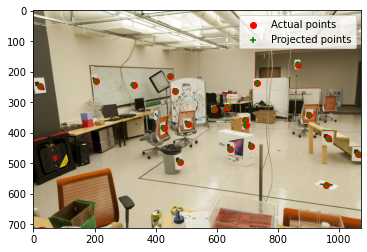

In [8]:
P = projection_matrix.estimate_camera_matrix(points_2d, points_3d, initial_guess_P)

print('The projection matrix is\n', P)

[projected_2d_pts, residual] = evaluate_points(P, points_2d, points_3d);

# residual is the sum of Euclidean distances between actual and projected points
print('The total residual is {:f}'.format(residual))
visualize_points_image(points_2d, projected_2d_pts, '../data/pic_b.jpg')


**TODO:** copy this image (Right click -> Copy Image) to the report (Slide 2, left)

In [9]:
print('Test for estimate_camera_matrix:', verify(test_estimate_camera_matrix))

[[ 731.  238.]
 [  22.  248.]
 [ 204.  230.]
 [ 903.  342.]
 [ 635.  316.]
 [ 867.  177.]
 [ 958.  572.]
 [ 328.  244.]
 [ 426.  386.]
 [1064.  470.]
 [ 480.  495.]
 [ 964.  419.]
 [ 695.  374.]
 [ 505.  372.]
 [ 645.  452.]
 [ 692.  359.]
 [ 712.  444.]
 [ 465.  263.]
 [ 591.  324.]
 [ 447.  213.]]
[[312.747 309.14   30.086]
 [305.796 311.649  30.356]
 [307.694 312.358  30.418]
 [310.149 307.186  29.298]
 [311.937 310.105  29.216]
 [311.202 307.572  30.682]
 [307.106 306.876  28.66 ]
 [309.317 312.49   30.23 ]
 [307.435 310.151  29.318]
 [308.253 306.3    28.881]
 [306.65  309.301  28.905]
 [308.069 306.831  29.189]
 [309.671 308.834  29.029]
 [308.255 309.955  29.267]
 [307.546 308.613  28.963]
 [311.036 309.206  28.913]
 [307.518 308.175  29.069]
 [309.95  311.262  29.99 ]
 [312.16  310.772  29.08 ]
 [311.988 312.709  30.514]]
[[   785.    -232.5      0.  165750. ]
 [   390.     195.    -500.  160500. ]
 [    -1.      -0.5      0.       1. ]]
[[312.747 309.14   30.086]
 [305.796 311

[[  -6.09946416  -12.36565572  -11.05834616   -6.16270702   -6.49743707
    -6.30194289   -7.09391655   -9.60971596   -8.8735454    -6.44995625
    -8.65097525   -6.83261569   -6.88833518   -8.22405087   -7.79141353
    -6.4301055    -7.64032254   -8.28846021   -6.61444247   -8.12725088]
 [ -77.61113405 -137.13320837 -124.71362164  -77.25822918  -79.82920087
   -80.75536969  -84.922283   -110.51402771 -102.10907525  -79.40693544
   -99.36185714  -83.40025898  -83.34240436  -95.9975724   -91.63623271
   -78.85531072  -90.50151914  -97.7807373   -80.60069252  -97.02260811]]
[[ 731.  238.]
 [  22.  248.]
 [ 204.  230.]
 [ 903.  342.]
 [ 635.  316.]
 [ 867.  177.]
 [ 958.  572.]
 [ 328.  244.]
 [ 426.  386.]
 [1064.  470.]
 [ 480.  495.]
 [ 964.  419.]
 [ 695.  374.]
 [ 505.  372.]
 [ 645.  452.]
 [ 692.  359.]
 [ 712.  444.]
 [ 465.  263.]
 [ 591.  324.]
 [ 447.  213.]]
[[312.747 309.14   30.086]
 [305.796 311.649  30.356]
 [307.694 312.358  30.418]
 [310.149 307.186  29.298]
 [311.937 31

[[ 57.10649577  89.93907968  83.70221249  57.02896939  58.72234081
   58.84638028  61.92045338  76.290397    71.91579938  58.44935078
   70.47793024  60.83822069  60.90415713  68.41539988  65.91509369
   58.17090536  65.19125303  69.22371351  59.25325153  68.6487322 ]
 [-35.81955284 -56.05438082 -52.20919176 -35.80319185 -36.86293987
  -36.85629276 -38.85476063 -47.65337193 -45.00185934 -36.69753344
  -44.13584403 -38.15821592 -38.21492513 -42.84335999 -41.31177123
  -36.53442306 -40.85703985 -43.30490861 -37.2000267  -42.92591262]]
[[ 731.  238.]
 [  22.  248.]
 [ 204.  230.]
 [ 903.  342.]
 [ 635.  316.]
 [ 867.  177.]
 [ 958.  572.]
 [ 328.  244.]
 [ 426.  386.]
 [1064.  470.]
 [ 480.  495.]
 [ 964.  419.]
 [ 695.  374.]
 [ 505.  372.]
 [ 645.  452.]
 [ 692.  359.]
 [ 712.  444.]
 [ 465.  263.]
 [ 591.  324.]
 [ 447.  213.]]
[[312.747 309.14   30.086]
 [305.796 311.649  30.356]
 [307.694 312.358  30.418]
 [310.149 307.186  29.298]
 [311.937 310.105  29.216]
 [311.202 307.572  30.682

[[312.747 309.14   30.086]
 [305.796 311.649  30.356]
 [307.694 312.358  30.418]
 [310.149 307.186  29.298]
 [311.937 310.105  29.216]
 [311.202 307.572  30.682]
 [307.106 306.876  28.66 ]
 [309.317 312.49   30.23 ]
 [307.435 310.151  29.318]
 [308.253 306.3    28.881]
 [306.65  309.301  28.905]
 [308.069 306.831  29.189]
 [309.671 308.834  29.029]
 [308.255 309.955  29.267]
 [307.546 308.613  28.963]
 [311.036 309.206  28.913]
 [307.518 308.175  29.069]
 [309.95  311.262  29.99 ]
 [312.16  310.772  29.08 ]
 [311.988 312.709  30.514]]
[[312.747 305.796 307.694 310.149 311.937 311.202 307.106 309.317 307.435
  308.253 306.65  308.069 309.671 308.255 307.546 311.036 307.518 309.95
  312.16  311.988]
 [309.14  311.649 312.358 307.186 310.105 307.572 306.876 312.49  310.151
  306.3   309.301 306.831 308.834 309.955 308.613 309.206 308.175 311.262
  310.772 312.709]
 [ 30.086  30.356  30.418  29.298  29.216  30.682  28.66   30.23   29.318
   28.881  28.905  29.189  29.029  29.267  28.963  2

[[-12308214.8647131   -2470195.83983233  -3948433.4974034
   10935051.46847635]
 [  9575702.36387175     74443.79256152  -3625204.42915941
   21145052.12237573]
 [ -3244561.19269843   2809475.85057956   3342697.20399893
          1.        ]]
[[312.747 309.14   30.086]
 [305.796 311.649  30.356]
 [307.694 312.358  30.418]
 [310.149 307.186  29.298]
 [311.937 310.105  29.216]
 [311.202 307.572  30.682]
 [307.106 306.876  28.66 ]
 [309.317 312.49   30.23 ]
 [307.435 310.151  29.318]
 [308.253 306.3    28.881]
 [306.65  309.301  28.905]
 [308.069 306.831  29.189]
 [309.671 308.834  29.029]
 [308.255 309.955  29.267]
 [307.546 308.613  28.963]
 [311.036 309.206  28.913]
 [307.518 308.175  29.069]
 [309.95  311.262  29.99 ]
 [312.16  310.772  29.08 ]
 [311.988 312.709  30.514]]
[[312.747 305.796 307.694 310.149 311.937 311.202 307.106 309.317 307.435
  308.253 306.65  308.069 309.671 308.255 307.546 311.036 307.518 309.95
  312.16  311.988]
 [309.14  311.649 312.358 307.186 310.105 307.572 

[[267.34971513 476.59649677 432.57712731 255.59918276 257.55033336
  294.05149336 268.1659596  375.38271697 326.8992149  256.64583734
  310.1104949  273.76143602 266.96397408 307.74948339 290.66825496
  250.97331705 290.5268645  329.01402859 256.49146186 337.33823039]
 [-54.1984919  -93.572448   -85.28205934 -51.83945329 -52.10249942
  -59.45031971 -54.03111696 -74.4438456  -65.11360175 -51.95178465
  -61.86773175 -55.22649849 -53.85032171 -61.5183241  -58.27268893
  -50.81898254 -58.29155957 -65.69377247 -51.85076242 -67.38121583]]
[[ 731.  238.]
 [  22.  248.]
 [ 204.  230.]
 [ 903.  342.]
 [ 635.  316.]
 [ 867.  177.]
 [ 958.  572.]
 [ 328.  244.]
 [ 426.  386.]
 [1064.  470.]
 [ 480.  495.]
 [ 964.  419.]
 [ 695.  374.]
 [ 505.  372.]
 [ 645.  452.]
 [ 692.  359.]
 [ 712.  444.]
 [ 465.  263.]
 [ 591.  324.]
 [ 447.  213.]]
[[312.747 309.14   30.086]
 [305.796 311.649  30.356]
 [307.694 312.358  30.418]
 [310.149 307.186  29.298]
 [311.937 310.105  29.216]
 [311.202 307.572  30.682

[[808.20915638 337.07747272 364.92220039 905.19376884 859.15959073
  652.15203661 743.24316529 419.52201125 494.39791757 871.1903343
  533.28559762 723.30931044 761.69708699 548.13224789 610.62848497
  930.55113426 615.7874272  500.73638066 860.01510032 488.99826699]
 [484.05264007 212.96532092 229.00203002 543.97341602 519.68785001
  390.54049646 453.60423632 261.05481598 306.84748135 526.49813177
  330.85235356 438.94680553 463.30437687 338.24406861 375.45048928
  562.8287168  377.74916334 308.34640033 521.5069044  300.13857267]]
[[ 731.  238.]
 [  22.  248.]
 [ 204.  230.]
 [ 903.  342.]
 [ 635.  316.]
 [ 867.  177.]
 [ 958.  572.]
 [ 328.  244.]
 [ 426.  386.]
 [1064.  470.]
 [ 480.  495.]
 [ 964.  419.]
 [ 695.  374.]
 [ 505.  372.]
 [ 645.  452.]
 [ 692.  359.]
 [ 712.  444.]
 [ 465.  263.]
 [ 591.  324.]
 [ 447.  213.]]
[[312.747 309.14   30.086]
 [305.796 311.649  30.356]
 [307.694 312.358  30.418]
 [310.149 307.186  29.298]
 [311.937 310.105  29.216]
 [311.202 307.572  30.682]

[[312.747 309.14   30.086]
 [305.796 311.649  30.356]
 [307.694 312.358  30.418]
 [310.149 307.186  29.298]
 [311.937 310.105  29.216]
 [311.202 307.572  30.682]
 [307.106 306.876  28.66 ]
 [309.317 312.49   30.23 ]
 [307.435 310.151  29.318]
 [308.253 306.3    28.881]
 [306.65  309.301  28.905]
 [308.069 306.831  29.189]
 [309.671 308.834  29.029]
 [308.255 309.955  29.267]
 [307.546 308.613  28.963]
 [311.036 309.206  28.913]
 [307.518 308.175  29.069]
 [309.95  311.262  29.99 ]
 [312.16  310.772  29.08 ]
 [311.988 312.709  30.514]]
[[312.747 305.796 307.694 310.149 311.937 311.202 307.106 309.317 307.435
  308.253 306.65  308.069 309.671 308.255 307.546 311.036 307.518 309.95
  312.16  311.988]
 [309.14  311.649 312.358 307.186 310.105 307.572 306.876 312.49  310.151
  306.3   309.301 306.831 308.834 309.955 308.613 309.206 308.175 311.262
  310.772 312.709]
 [ 30.086  30.356  30.418  29.298  29.216  30.682  28.66   30.23   29.318
   28.881  28.905  29.189  29.029  29.267  28.963  2

    1.      1.   ]]
[[835.61283287 257.5363368  298.25089915 899.26514541 835.36296624
  703.51881362 702.22150841 366.95228081 433.46060604 847.96132969
  464.7297586  710.85047162 732.49780897 498.61612803 563.35124184
  891.45270078 577.27750168 469.19504726 825.05001752 471.98974665]
 [268.1384787  341.95340015 337.1016315  324.4289922  370.83306328
  224.18640917 403.10052864 340.16792084 381.15986336 366.41052266
  406.72565304 346.61126325 382.34999575 380.31092898 392.94641956
  395.45552768 378.67450148 336.81533087 394.93039201 310.44545357]]
[[ 731.  238.]
 [  22.  248.]
 [ 204.  230.]
 [ 903.  342.]
 [ 635.  316.]
 [ 867.  177.]
 [ 958.  572.]
 [ 328.  244.]
 [ 426.  386.]
 [1064.  470.]
 [ 480.  495.]
 [ 964.  419.]
 [ 695.  374.]
 [ 505.  372.]
 [ 645.  452.]
 [ 692.  359.]
 [ 712.  444.]
 [ 465.  263.]
 [ 591.  324.]
 [ 447.  213.]]
[[312.747 309.14   30.086]
 [305.796 311.649  30.356]
 [307.694 312.358  30.418]
 [310.149 307.186  29.298]
 [311.937 310.105  29.216]
 [311

[[-15478950.50486062  15325422.86770968  -3137478.36969432
   10647721.84825307]
 [  3579328.25002096  -4579559.69175314   7339666.88295604
   20953612.29637719]
 [     3813.92236799      -106.37866912    -45989.43978982
          1.        ]]
[[312.747 309.14   30.086]
 [305.796 311.649  30.356]
 [307.694 312.358  30.418]
 [310.149 307.186  29.298]
 [311.937 310.105  29.216]
 [311.202 307.572  30.682]
 [307.106 306.876  28.66 ]
 [309.317 312.49   30.23 ]
 [307.435 310.151  29.318]
 [308.253 306.3    28.881]
 [306.65  309.301  28.905]
 [308.069 306.831  29.189]
 [309.671 308.834  29.029]
 [308.255 309.955  29.267]
 [307.546 308.613  28.963]
 [311.036 309.206  28.913]
 [307.518 308.175  29.069]
 [309.95  311.262  29.99 ]
 [312.16  310.772  29.08 ]
 [311.988 312.709  30.514]]
[[312.747 305.796 307.694 310.149 311.937 311.202 307.106 309.317 307.435
  308.253 306.65  308.069 309.671 308.255 307.546 311.036 307.518 309.95
  312.16  311.988]
 [309.14  311.649 312.358 307.186 310.105 307.572

[[843.03152594  13.2755659  163.1317169  854.83828345 806.62861354
  795.93473254 731.20948108 344.55897574 458.61387369 822.51333189
  497.56643947 756.47320431 752.2010233  550.71737338 620.27008611
  825.24527458 640.1535771  527.00616987 792.50263977 538.47345493]
 [246.58162703 232.11016637 234.9811579  335.56784972 392.91528572
  138.45387144 444.92768324 275.25249201 404.7410542  390.13292455
  466.66577666 353.10623082 409.74706586 403.65175135 430.83572899
  426.56006844 402.83971214 295.74776738 425.8154035  228.62165821]]
[[ 731.  238.]
 [  22.  248.]
 [ 204.  230.]
 [ 903.  342.]
 [ 635.  316.]
 [ 867.  177.]
 [ 958.  572.]
 [ 328.  244.]
 [ 426.  386.]
 [1064.  470.]
 [ 480.  495.]
 [ 964.  419.]
 [ 695.  374.]
 [ 505.  372.]
 [ 645.  452.]
 [ 692.  359.]
 [ 712.  444.]
 [ 465.  263.]
 [ 591.  324.]
 [ 447.  213.]]
[[312.747 309.14   30.086]
 [305.796 311.649  30.356]
 [307.694 312.358  30.418]
 [310.149 307.186  29.298]
 [311.937 310.105  29.216]
 [311.202 307.572  30.682

[[312.747 309.14   30.086]
 [305.796 311.649  30.356]
 [307.694 312.358  30.418]
 [310.149 307.186  29.298]
 [311.937 310.105  29.216]
 [311.202 307.572  30.682]
 [307.106 306.876  28.66 ]
 [309.317 312.49   30.23 ]
 [307.435 310.151  29.318]
 [308.253 306.3    28.881]
 [306.65  309.301  28.905]
 [308.069 306.831  29.189]
 [309.671 308.834  29.029]
 [308.255 309.955  29.267]
 [307.546 308.613  28.963]
 [311.036 309.206  28.913]
 [307.518 308.175  29.069]
 [309.95  311.262  29.99 ]
 [312.16  310.772  29.08 ]
 [311.988 312.709  30.514]]
[[312.747 305.796 307.694 310.149 311.937 311.202 307.106 309.317 307.435
  308.253 306.65  308.069 309.671 308.255 307.546 311.036 307.518 309.95
  312.16  311.988]
 [309.14  311.649 312.358 307.186 310.105 307.572 306.876 312.49  310.151
  306.3   309.301 306.831 308.834 309.955 308.613 309.206 308.175 311.262
  310.772 312.709]
 [ 30.086  30.356  30.418  29.298  29.216  30.682  28.66   30.23   29.318
   28.881  28.905  29.189  29.029  29.267  28.963  2

[[  -148271.04351215    318406.67779246   -407349.26459119
  -41647291.70231993]
 [   -19008.58193179     68801.11823446      2756.1375027
  -15993599.49347813]
 [     -134.27408526       179.18380621      -522.96806226
          1.        ]]
[[312.747 309.14   30.086]
 [305.796 311.649  30.356]
 [307.694 312.358  30.418]
 [310.149 307.186  29.298]
 [311.937 310.105  29.216]
 [311.202 307.572  30.682]
 [307.106 306.876  28.66 ]
 [309.317 312.49   30.23 ]
 [307.435 310.151  29.318]
 [308.253 306.3    28.881]
 [306.65  309.301  28.905]
 [308.069 306.831  29.189]
 [309.671 308.834  29.029]
 [308.255 309.955  29.267]
 [307.546 308.613  28.963]
 [311.036 309.206  28.913]
 [307.518 308.175  29.069]
 [309.95  311.262  29.99 ]
 [312.16  310.772  29.08 ]
 [311.988 312.709  30.514]]
[[312.747 305.796 307.694 310.149 311.937 311.202 307.106 309.317 307.435
  308.253 306.65  308.069 309.671 308.255 307.546 311.036 307.518 309.95
  312.16  311.988]
 [309.14  311.649 312.358 307.186 310.105 307.572 

 [      -4.2952802         5.7122161       -16.57906531        1.        ]]
[[312.747 309.14   30.086]
 [305.796 311.649  30.356]
 [307.694 312.358  30.418]
 [310.149 307.186  29.298]
 [311.937 310.105  29.216]
 [311.202 307.572  30.682]
 [307.106 306.876  28.66 ]
 [309.317 312.49   30.23 ]
 [307.435 310.151  29.318]
 [308.253 306.3    28.881]
 [306.65  309.301  28.905]
 [308.069 306.831  29.189]
 [309.671 308.834  29.029]
 [308.255 309.955  29.267]
 [307.546 308.613  28.963]
 [311.036 309.206  28.913]
 [307.518 308.175  29.069]
 [309.95  311.262  29.99 ]
 [312.16  310.772  29.08 ]
 [311.988 312.709  30.514]]
[[312.747 305.796 307.694 310.149 311.937 311.202 307.106 309.317 307.435
  308.253 306.65  308.069 309.671 308.255 307.546 311.036 307.518 309.95
  312.16  311.988]
 [309.14  311.649 312.358 307.186 310.105 307.572 306.876 312.49  310.151
  306.3   309.301 306.831 308.834 309.955 308.613 309.206 308.175 311.262
  310.772 312.709]
 [ 30.086  30.356  30.418  29.298  29.216  30.682 

[[788.71614368 111.6122384  162.63850803 913.87977107 663.3873075
  865.7585462  927.07644729 241.83910787 404.06794735 987.77526408
  466.50115726 920.05650816 739.56398112 503.83425714 683.55182736
  736.21321782 753.97545933 466.3542284  574.43618072 422.79203299]
 [250.85204522 257.30455116 213.90750258 350.06745537 316.94740384
  243.59470262 517.48456874 215.11419203 402.92676625 435.02194233
  533.49896622 399.30712502 387.65842794 386.70133723 461.46197678
  373.22642296 437.28296948 253.33785562 323.64355643 178.81010321]]
[[ 731.  238.]
 [  22.  248.]
 [ 204.  230.]
 [ 903.  342.]
 [ 635.  316.]
 [ 867.  177.]
 [ 958.  572.]
 [ 328.  244.]
 [ 426.  386.]
 [1064.  470.]
 [ 480.  495.]
 [ 964.  419.]
 [ 695.  374.]
 [ 505.  372.]
 [ 645.  452.]
 [ 692.  359.]
 [ 712.  444.]
 [ 465.  263.]
 [ 591.  324.]
 [ 447.  213.]]
[[312.747 309.14   30.086]
 [305.796 311.649  30.356]
 [307.694 312.358  30.418]
 [310.149 307.186  29.298]
 [311.937 310.105  29.216]
 [311.202 307.572  30.682]

   369.39661681  440.85481786  254.18098426  322.18024813  183.90813083]]
[[ 731.  238.]
 [  22.  248.]
 [ 204.  230.]
 [ 903.  342.]
 [ 635.  316.]
 [ 867.  177.]
 [ 958.  572.]
 [ 328.  244.]
 [ 426.  386.]
 [1064.  470.]
 [ 480.  495.]
 [ 964.  419.]
 [ 695.  374.]
 [ 505.  372.]
 [ 645.  452.]
 [ 692.  359.]
 [ 712.  444.]
 [ 465.  263.]
 [ 591.  324.]
 [ 447.  213.]]
[[312.747 309.14   30.086]
 [305.796 311.649  30.356]
 [307.694 312.358  30.418]
 [310.149 307.186  29.298]
 [311.937 310.105  29.216]
 [311.202 307.572  30.682]
 [307.106 306.876  28.66 ]
 [309.317 312.49   30.23 ]
 [307.435 310.151  29.318]
 [308.253 306.3    28.881]
 [306.65  309.301  28.905]
 [308.069 306.831  29.189]
 [309.671 308.834  29.029]
 [308.255 309.955  29.267]
 [307.546 308.613  28.963]
 [311.036 309.206  28.913]
 [307.518 308.175  29.069]
 [309.95  311.262  29.99 ]
 [312.16  310.772  29.08 ]
 [311.988 312.709  30.514]]
[[   -7.66259152    13.46400009   -14.77433915 -1409.24192393]
 [   -1.09715734     

[[ 731.43739123   22.28331409  204.1253788   902.64059383  636.35496987
   866.65395545  958.35321057  327.11963321  425.11433211 1063.05978575
   479.88583225  965.00945467  693.8061048   505.48865145  644.45724698
   691.24654925  713.01338762  465.23868374  591.97213169  446.75067959]
 [ 238.30654956  248.11489082  229.79547902  342.1559747   316.57224911
   176.22788397  571.81901876  244.37087708  385.65814464  470.31241338
   494.98969331  419.49532011  374.19896409  371.68133605  452.23909521
   357.99285057  443.7209305   263.31192522  323.83788464  213.19318651]]
[[ 731.  238.]
 [  22.  248.]
 [ 204.  230.]
 [ 903.  342.]
 [ 635.  316.]
 [ 867.  177.]
 [ 958.  572.]
 [ 328.  244.]
 [ 426.  386.]
 [1064.  470.]
 [ 480.  495.]
 [ 964.  419.]
 [ 695.  374.]
 [ 505.  372.]
 [ 645.  452.]
 [ 692.  359.]
 [ 712.  444.]
 [ 465.  263.]
 [ 591.  324.]
 [ 447.  213.]]
[[312.747 309.14   30.086]
 [305.796 311.649  30.356]
 [307.694 312.358  30.418]
 [310.149 307.186  29.298]
 [311.937 31

## Part 1.4 Decompose projection matrix by RQ decomposition

Recall that $ \mathbf{P} =\mathbf{K}\ {}^w\mathbf{R}^T_c[\mathbf{I}| -{}^w\mathbf{t}_c] $. Rewriting this gives us:

\begin{align} 
\mathbf{P} &= [\mathbf{K}\ {}^w\mathbf{R}^T_c| - \mathbf{K}\ {}^w\mathbf{R}^T_c {}^w\mathbf{t}_c] \\
&= [\mathbf{K}\ {}^c\mathbf{R}_w| \mathbf{K}\ {}^c\mathbf{t}_w] \\
&= [\mathbf{M}| \mathbf{K}\ {}^c\mathbf{t}_w]. 
\end{align}

**Note:** Pay attention to the flip in coordinate system in line 2. Do not proceed further if you have questions about this step. Working out an example by hand helps understand this, particularly the translation portion. The TAs will be happy to help you understand the coordinate system.

Where $\mathbf{M} = \mathbf{K}\ {}^c\mathbf{R}_w $ is the first 3 columns of $\mathbf{P}$. An operation known as RQ decomposition which will decompose $ \mathbf{M} $ into an upper triangular matrix $\mathbf{R}$ and an orthonormal matrix $ \mathbf{Q} $ such that $ \mathbf{RQ} = \mathbf{M} $, where the upper triangular matrix will correspond to $ \mathbf{K} $ and the orthonormal matrix to $ {}^c\mathbf{R}_w $. In this part you will implement `decompose_camera_matrix(P)` that takes as input the camera matrix $\mathbf{P}$ and outputs the intrinsic $\mathbf{K}$ and rotation matrix ${}^c \mathbf{R}_w$, 

**TODO:** implement `decompose_camera_matrix()` in `projection_matrix.py`

In [10]:
print('Test for decomposing projection matrix:', verify(test_decompose_camera_matrix))
K, cRw = projection_matrix.decompose_camera_matrix(P)

Test for decomposing projection matrix: "Correct"


## Part 1.5 Calculate Camera Center by previous optimized P, intrinsic matrix K and rotation matrix ${}^w\mathbf{R}^T_c $

In this part in `projection_matrix.py` you will implement `calculate_camera_center(P, K, cRw)` that takes as input the 
projection $\mathbf{P}$, intrinsic $\mathbf{K}$ and extrinsic ${}^c\mathbf{R}_w$ matrix and outputs the camera position in world coordinates.

**TODO:** complete `calculate_camera_center` in `projection_matrix.py`

In [11]:
print('Test for calculating camera center:', verify(test_calculate_camera_center))
center = projection_matrix.calculate_camera_center(P, K, cRw)

[[ 0.00550818 -0.00153966 13.69268752]
 [-0.00557856 -0.00210015 28.51071987]
 [ 0.00004887 -0.00754374  1.16492928]]
[1637.28675475 2880.869899      1.        ]
Test for calculating camera center: "Correct"
[[  -0.22033672    0.11279152 -267.90536263]
 [   0.45875971    0.02612867 -423.83002553]
 [   0.01818477    0.49275235 -116.76257105]]
[244.82283619 166.18819426   1.        ]


We can now visualize the camera center and the camera coordinate system as well as the  the world coordinate system.

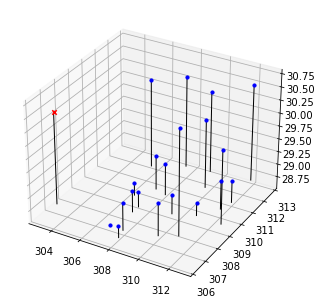

In [12]:
plot3dview(points_3d, center)

### Questions
*put these answers in your report* (Slide 2)

1. What is the minimum number of 3D-2D point correspondences needed to estimate the projection matrix? Why?

## Part 2: Taking Your Own Images and Estimating the Projection Matrix + Camera Pose

In part 1 you were given a set of known points in world coordinates. In this part of the assignment you will learn how to use a fiducial---an object of known size that can be used as a reference. Any object for which you have measured the size given some unit (in this project you should use centimeters).

![projection_figure.png](https://dellaert.github.io/19F-4476/images/proj3/projection_figure.png)

<center>Example of how one cuboid of known dimensions can be used as a fiducial to create multiple world coordinate systems<center>

 <br>

The figure above illustrates how a cuboid of known dimension can be used to create a world coordinate system and a set of points with known 3D location. Choose an object that you will use as a fiducial (we recommend using a thick textbook) and measure it. Using a camera capture two images of the object (you will estimate the camera parameters for both images) keeping in mind the considerations discussed in class for part 2 and fundamental matrix estimation if you want to reuse these images. When taking the images, try to estimate the pose of the camera lens of your phone in the world coordinate system.

Now that you have the dimension of your object (3D points), you can use the Jupyter notebook to find the image coordinates of the 3D points create your own 2D-3D correspondences for each image. For each of your 2 images, make initial estimates for $\mathbf{P}$ and if your estimate is good, using your code from the previous part you should be able to estimate both the the projection matrix and the camera pose. Use the code available in the Jupyter notebook to visualize your findings.

### Part 2.1 Take two images of your fiducial object and measure the corresponding 2D and 3D points

**TODO:** take two images by yourself and save it under the *../data/* path. Please consider using a **box-like fiducial object**, for example a book, because you will need to mark the vertices over your fiducial object, and it's easier to use a box-like fiducial object. Fill out the `points_3d` variable with the 3D point locations of the points you'll use for correspondences, and `points2d_img1` and `points2d_img2` with these coordinate values.

**TODO:** Copy those two images to the report

In [18]:
image1_path = '../data/book_img1.jpg'
image2_path = '../data/book_img2.jpg'

img1 = load_image(image1_path)
img2 = load_image(image2_path)

Measure your fiducial object and define a coordinate system. Fill out the `points_3d` variable with the 3D point locations of the points you'll use for correspondences.

In [19]:
points_3d = np.array([[0    , 0,  0],
                      [23.5 , 0,  0],
                      [0    , 21, 0],
                      [0    , 0,  4],
                      [23.5 , 0 , 4],
                      [23.5 , 21, 4],
                      [0    , 21, 4]])

Remember the units you have taken this measurements in. Use the same units when talking about world coordinate system later.

Now for each image, find the 2D pixel locations of your 3D points. Hovering over the interactive images below, and it will give you the `x,y` coordinates of your cursor on the image. The coordinates will be displayed in the bottom right corner. You can use the lower left side controls to zoom into the image for more precise measurements. 

<IPython.core.display.Javascript object>


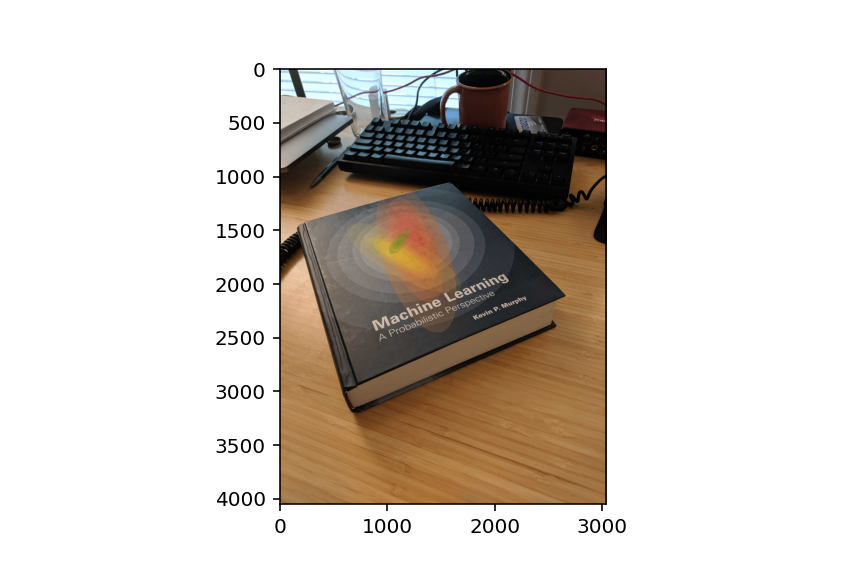

In [20]:
# it's known to have problem (showing blank plot) when switching from `matplotlib inline` 
# to `matplotlib notebook`, and calling `matplotlib notebook` twice can resolve that
# in some cases. 
# refer: https://stackoverflow.com/questions/41125690/matplotlib-notebook-showing-a-blank-histogram?noredirect=1&lq=1
%matplotlib notebook
%matplotlib notebook

# plotting image 1
fig = plt.figure(); ax = fig.add_subplot(111); ax.imshow(img1)

In [21]:
points2d_img1 = np.array([[700,  3210],
                          [230,  1710],
                          [2565, 2410],
                          [636,  2878],
                          [176,  1465],
                          [1555, 1085],
                          [2640, 2135]])

In [ ]:
# it's known to have problem (showing blank plot) when switching from `matplotlib inline` 
# to `matplotlib notebook`, and calling `matplotlib notebook` twice can resolve that
# in some cases. 
# refer: https://stackoverflow.com/questions/41125690/matplotlib-notebook-showing-a-blank-histogram?noredirect=1&lq=1
%matplotlib notebook
%matplotlib notebook

# plotting image 2
fig = plt.figure(); ax = fig.add_subplot(111); ax.imshow(img2)

In [22]:
points2d_img2 = np.array([[2356, 3210],
                          [154, 2169],
                          [2794, 1884],
                          [2487, 2902],
                          [90, 1873],
                          [1140, 1073 ],
                          [2859, 1577]])

Our objective function will need to read the measurements you just saved from disk. We need to save this data now.

In [23]:
np.savetxt('../data/pts3d_fiducial.npy', points_3d)
np.savetxt('../data/pts2d_image1.npy', points2d_img1)
np.savetxt('../data/pts2d_image2.npy', points2d_img2)

## Part 2.2 Making your own $\mathbf{K}$,  ${}^w\mathbf{R}_c^T$ and $[\mathbf{I}|{}^w\mathbf{t}_c]$ estimates and visualize your camera pose.

Make a **good** initial estimate of the projection matrix. For rotations, you can try to guess the angle of rotation along each axis in jumps of 30 degrees (i.e. 0, 30, 60, 90). For the translation, use the same unit you used for 3D points. You need to get the answer in the same ballpark, i.e. do not use 300cm when the actual distance was 30cm. However, 25cm should be fine.

Note the convention of the camera coordinate system and the world coordinate system again. World coordinate system is up to you, but for camera Z shoots out of the camera, Y goes down the camera and X goes to the right.

In [24]:
initial_guess_K = np.array([[ 500,   0, 2024],
                            [   0, 500, 1518],
                            [   0,   0,  1]])

initial_guess_R_T = np.array([[ 0.5,   -1,  0],
                            [   0,    0, -1],
                            [   1,  0.5,  0]])

initial_guess_t = np.array([-30, -30, 30]).reshape(3, 1)

initial_guess_I_t = np.hstack((np.eye(3), initial_guess_t))

initial_guess_P = np.matmul(initial_guess_K, np.matmul(initial_guess_R_T, initial_guess_I_t))

In [25]:
# set the paths and load the data
pts2d_path = '../data/pts2d_image1.npy'
pts3d_path = '../data/pts3d_fiducial.npy'

points_2d = np.loadtxt(pts2d_path)
points_3d = np.loadtxt(pts3d_path)
img = load_image(image1_path)
np.array(img.shape[:2])/2

array([2024., 1518.])

Visualize your estimate for the camera pose relative to the world coordinate system. RGB colors correspond with XYZ (first, second and third coordinate). Be mindful of whether you should be passing R or R.T in for your rotation matrix.

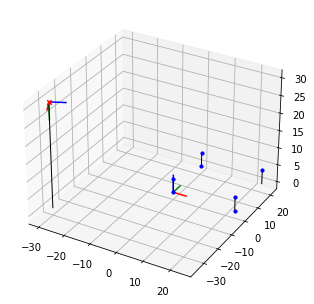

In [26]:
%matplotlib inline
plot3dview_with_coordinates(points_3d, initial_guess_I_t[:,3], initial_guess_R_T.T)

**TODO:** check the plot above roughly corresponds with how you captured the image. For the camera, x axis should go to the right of the camera, y axis down, and z axis projected out of the camera.

**TODO:** copy this image to the report (Slide 4, left)

View the optimization results given your initial guess. If your initial guess is poor the optimizition **will not** work.

[[ 700. 3210.]
 [ 230. 1710.]
 [2565. 2410.]
 [ 636. 2878.]
 [ 176. 1465.]
 [1555. 1085.]
 [2640. 2135.]]
[[ 0.   0.   0. ]
 [23.5  0.   0. ]
 [ 0.  21.   0. ]
 [ 0.   0.   4. ]
 [23.5  0.   4. ]
 [23.5 21.   4. ]
 [ 0.  21.   4. ]]
[[  2274.     512.       0.  -83580. ]
 [  1518.     759.    -500.  -83310. ]
 [     1.       0.5      0.       1. ]]
[[ 0.   0.   0. ]
 [23.5  0.   0. ]
 [ 0.  21.   0. ]
 [ 0.   0.   4. ]
 [23.5  0.   4. ]
 [23.5 21.   4. ]
 [ 0.  21.   4. ]]
[[ 0.  23.5  0.   0.  23.5 23.5  0. ]
 [ 0.   0.  21.   0.   0.  21.  21. ]
 [ 0.   0.   0.   4.   4.   4.   4. ]
 [ 1.   1.   1.   1.   1.   1.   1. ]]
[[-83580.          -1230.24489796  -6332.86956522 -83580.
   -1230.24489796   -553.97142857  -6332.86956522]
 [-83310.          -1944.36734694  -5858.34782609 -85310.
   -2026.           -962.8         -6032.26086957]]
[[ 700. 3210.]
 [ 230. 1710.]
 [2565. 2410.]
 [ 636. 2878.]
 [ 176. 1465.]
 [1555. 1085.]
 [2640. 2135.]]
[[ 0.   0.   0. ]
 [23.5  0.   0. ]
 [ 0.  2

[[ 700.00568831   -0.20034611   -1.0273006   635.861063     -0.21042884
    -0.71580092   -1.0335371 ]
 [3210.01475792   -1.38213705   -2.8268702  2877.88916289   -1.42784475
    -2.29459121   -2.85511955]]
[[ 700. 3210.]
 [ 230. 1710.]
 [2565. 2410.]
 [ 636. 2878.]
 [ 176. 1465.]
 [1555. 1085.]
 [2640. 2135.]]
[[ 0.   0.   0. ]
 [23.5  0.   0. ]
 [ 0.  21.   0. ]
 [ 0.   0.   4. ]
 [23.5  0.   4. ]
 [23.5 21.   4. ]
 [ 0.  21.   4. ]]
[[  -5422.30298353  -50123.25532492   -1593.87490583     700.00568831]
 [ -37338.19483855 -137987.5930413    -7224.28489297    3210.01475792]
 [  26915.95579874   48758.72925581      -2.48142058       1.        ]]
[[ 0.   0.   0. ]
 [23.5  0.   0. ]
 [ 0.  21.   0. ]
 [ 0.   0.   4. ]
 [23.5  0.   4. ]
 [23.5 21.   4. ]
 [ 0.  21.   4. ]]
[[ 0.  23.5  0.   0.  23.5 23.5  0. ]
 [ 0.   0.  21.   0.   0.  21.  21. ]
 [ 0.   0.   0.   4.   4.   4.   4. ]
 [ 1.   1.   1.   1.   1.   1.   1. ]]
[[ 700.00568831   -0.20034611   -1.02730062  635.86107354   -0.210

 [ 0.  21.   4. ]]
[[ 0.  23.5  0.   0.  23.5 23.5  0. ]
 [ 0.   0.  21.   0.   0.  21.  21. ]
 [ 0.   0.   0.   4.   4.   4.   4. ]
 [ 1.   1.   1.   1.   1.   1.   1. ]]
[[ 700.00372079    5.90842325    0.45013616  636.00425645    6.01329575
     0.66098823    0.4543074 ]
 [3210.01849112   19.51241702   -0.18753955 2878.00007788   19.98788157
     0.57695574   -0.16866149]]
[[ 700. 3210.]
 [ 230. 1710.]
 [2565. 2410.]
 [ 636. 2878.]
 [ 176. 1465.]
 [1555. 1085.]
 [2640. 2135.]]
[[ 0.   0.   0. ]
 [23.5  0.   0. ]
 [ 0.  21.   0. ]
 [ 0.   0.   4. ]
 [23.5  0.   4. ]
 [23.5 21.   4. ]
 [ 0.  21.   4. ]]
[[ 34986.34743308  75687.83826281   3686.46251752    700.00372079]
 [115503.29702405 -31700.45435112  16671.10815665   3210.01849112]
 [  5926.43459295 168218.32063565      5.82144278      1.        ]]
[[ 0.   0.   0. ]
 [23.5  0.   0. ]
 [ 0.  21.   0. ]
 [ 0.   0.   4. ]
 [23.5  0.   4. ]
 [23.5 21.   4. ]
 [ 0.  21.   4. ]]
[[ 0.  23.5  0.   0.  23.5 23.5  0. ]
 [ 0.   0.  21.   0. 

 [2640. 2135.]]
[[ 0.   0.   0. ]
 [23.5  0.   0. ]
 [ 0.  21.   0. ]
 [ 0.   0.   4. ]
 [23.5  0.   4. ]
 [23.5 21.   4. ]
 [ 0.  21.   4. ]]
[[ 35016.31518041  75702.87417691   3690.24932894    700.01211602]
 [115719.14318355 -31687.91100969  16688.98105636   3210.11627973]
 [   100.55762141 168211.28643555      5.82622326      1.        ]]
[[ 0.   0.   0. ]
 [23.5  0.   0. ]
 [ 0.  21.   0. ]
 [ 0.   0.   4. ]
 [23.5  0.   4. ]
 [23.5 21.   4. ]
 [ 0.  21.   4. ]]
[[ 0.  23.5  0.   0.  23.5 23.5  0. ]
 [ 0.   0.  21.   0.   0.  21.  21. ]
 [ 0.   0.   0.   4.   4.   4.   4. ]
 [ 1.   1.   1.   1.   1.   1.   1. ]]
[[ 700.01211602  348.37019985    0.45024438  636.12744135  351.15240729
     0.68690958    0.45442008]
 [3210.11627973 1151.64555467   -0.18747279 2878.68127399 1168.36533239
     0.6008558    -0.1685737 ]]
[[ 700. 3210.]
 [ 230. 1710.]
 [2565. 2410.]
 [ 636. 2878.]
 [ 176. 1465.]
 [1555. 1085.]
 [2640. 2135.]]
[[ 0.   0.   0. ]
 [23.5  0.   0. ]
 [ 0.  21.   0. ]
 [ 0.   

 [2640. 2135.]]
[[ 0.   0.   0. ]
 [23.5  0.   0. ]
 [ 0.  21.   0. ]
 [ 0.   0.   4. ]
 [23.5  0.   4. ]
 [23.5 21.   4. ]
 [ 0.  21.   4. ]]
[[ 15987.20073157  78365.38816003   1900.07026893    700.00690472]
 [122100.48687979 -29470.11689625   8571.07041267   3210.04072801]
 [    77.21104526 166959.91270678      3.00822702      1.        ]]
[[ 0.   0.   0. ]
 [23.5  0.   0. ]
 [ 0.  21.   0. ]
 [ 0.   0.   4. ]
 [23.5  0.   4. ]
 [23.5 21.   4. ]
 [ 0.  21.   4. ]]
[[ 0.  23.5  0.   0.  23.5 23.5  0. ]
 [ 0.   0.  21.   0.   0.  21.  21. ]
 [ 0.   0.   0.   4.   4.   4.   4. ]
 [ 1.   1.   1.   1.   1.   1.   1. ]]
[[ 700.00690472  207.32999601    0.46956601  636.87152066  210.12371384
     0.57858636    0.47173208]
 [3210.04072801 1582.28337323   -0.17559454 2876.89609876 1590.6253016
     0.6522214    -0.16581567]]
[[ 700. 3210.]
 [ 230. 1710.]
 [2565. 2410.]
 [ 636. 2878.]
 [ 176. 1465.]
 [1555. 1085.]
 [2640. 2135.]]
[[ 0.   0.   0. ]
 [23.5  0.   0. ]
 [ 0.  21.   0. ]
 [ 0.   0

 [ 0.  21.   4. ]]
[[ 0.  23.5  0.   0.  23.5 23.5  0. ]
 [ 0.   0.  21.   0.   0.  21.  21. ]
 [ 0.   0.   0.   4.   4.   4.   4. ]
 [ 1.   1.   1.   1.   1.   1.   1. ]]
[[ 699.99515725  238.73411968   20.81623028  634.11031294  170.38556728
    21.62030546   20.24032945]
 [3210.01576619 1689.8720132     7.01680447 2880.02232967 1484.00506957
    14.97511023    4.31885839]]
[[ 700. 3210.]
 [ 230. 1710.]
 [2565. 2410.]
 [ 636. 2878.]
 [ 176. 1465.]
 [1555. 1085.]
 [2640. 2135.]]
[[ 0.   0.   0. ]
 [23.5  0.   0. ]
 [ 0.  21.   0. ]
 [ 0.   0.   4. ]
 [23.5  0.   4. ]
 [23.5 21.   4. ]
 [ 0.  21.   4. ]]
[[  12414.68865626  190700.13906983  -28616.20349804     699.99516768]
 [  87951.23621761   64140.21830767 -129977.66754293    3210.01576619]
 [     52.08437237    9162.68115751     -45.10213961       1.        ]]
[[ 0.   0.   0. ]
 [23.5  0.   0. ]
 [ 0.  21.   0. ]
 [ 0.   0.   4. ]
 [23.5  0.   4. ]
 [23.5 21.   4. ]
 [ 0.  21.   4. ]]
[[ 0.  23.5  0.   0.  23.5 23.5  0. ]
 [ 0.   0

 [2640. 2135.]]
[[ 0.   0.   0. ]
 [23.5  0.   0. ]
 [ 0.  21.   0. ]
 [ 0.   0.   4. ]
 [23.5  0.   4. ]
 [23.5 21.   4. ]
 [ 0.  21.   4. ]]
[[  12456.65610183  190926.3528647   -28596.27126544     700.11269346]
 [  87980.28531519   64330.66570993 -129963.67331243    3210.11650655]
 [     51.5423927      356.24206047     -45.21575979       1.        ]]
[[ 0.   0.   0. ]
 [23.5  0.   0. ]
 [ 0.  21.   0. ]
 [ 0.   0.   4. ]
 [23.5  0.   4. ]
 [23.5 21.   4. ]
 [ 0.  21.   4. ]]
[[ 0.  23.5  0.   0.  23.5 23.5  0. ]
 [ 0.   0.  21.   0.   0.  21.  21. ]
 [ 0.   0.   0.   4.   4.   4.   4. ]
 [ 1.   1.   1.   1.   1.   1.   1. ]]
[[ 700.11269346  242.05604787  535.96750775  632.06411328  173.59837536
   492.04303786  533.57771917]
 [3210.11650655 1708.18994764  180.98623707 2872.43326429 1503.70118921
   340.89251594  114.26848894]]
[[ 700. 3210.]
 [ 230. 1710.]
 [2565. 2410.]
 [ 636. 2878.]
 [ 176. 1465.]
 [1555. 1085.]
 [2640. 2135.]]
[[ 0.   0.   0. ]
 [23.5  0.   0. ]
 [ 0.  21.   0

[[ 700. 3210.]
 [ 230. 1710.]
 [2565. 2410.]
 [ 636. 2878.]
 [ 176. 1465.]
 [1555. 1085.]
 [2640. 2135.]]
[[ 0.   0.   0. ]
 [23.5  0.   0. ]
 [ 0.  21.   0. ]
 [ 0.   0.   4. ]
 [23.5  0.   4. ]
 [23.5 21.   4. ]
 [ 0.  21.   4. ]]
[[  12429.30687248  190557.39082086  -28642.505831       699.44947411]
 [  88007.71964499   65677.12688095 -129807.3365256     3212.35638566]
 [     53.42276369      67.98115874     -44.65160954       1.        ]]
[[ 0.   0.   0. ]
 [23.5  0.   0. ]
 [ 0.  21.   0. ]
 [ 0.   0.   4. ]
 [23.5  0.   4. ]
 [23.5 21.   4. ]
 [ 0.  21.   4. ]]
[[ 0.  23.5  0.   0.  23.5 23.5  0. ]
 [ 0.   0.  21.   0.   0.  21.  21. ]
 [ 0.   0.   0.   4.   4.   4.   4. ]
 [ 1.   1.   1.   1.   1.   1.   1. ]]
[[ 699.44947411  233.03089568 2801.61872857  641.13989909  165.34925199
  1668.34379861 3110.27294338]
 [3212.35638566 1648.62794811  967.68012555 2905.39574475 1440.08477205
  1170.01104049  690.56330251]]
[[ 700. 3210.]
 [ 230. 1710.]
 [2565. 2410.]
 [ 636. 2878.]
 [ 176

 [ 0.  21.   4. ]]
[[ 0.  23.5  0.   0.  23.5 23.5  0. ]
 [ 0.   0.  21.   0.   0.  21.  21. ]
 [ 0.   0.   0.   4.   4.   4.   4. ]
 [ 1.   1.   1.   1.   1.   1.   1. ]]
[[ 699.99778292  255.02410109 2560.13526468  646.12361951  221.03169398
  1362.66613901 2751.85604453]
 [3210.3846668  1494.95615493 2135.17602225 2897.90656856 1372.89928482
  1744.076641   2058.38922043]]
[[ 700. 3210.]
 [ 230. 1710.]
 [2565. 2410.]
 [ 636. 2878.]
 [ 176. 1465.]
 [1555. 1085.]
 [2640. 2135.]]
[[ 0.   0.   0. ]
 [23.5  0.   0. ]
 [ 0.  21.   0. ]
 [ 0.   0.   4. ]
 [23.5  0.   4. ]
 [23.5 21.   4. ]
 [ 0.  21.   4. ]]
[[ 11740.22193482 115891.55860157 -14002.35154788    699.99779335]
 [ 68859.406045    96529.53536015 -62819.17111969   3210.3846668 ]
 [    46.10998308     45.23314929    -21.65047427      1.        ]]
[[ 0.   0.   0. ]
 [23.5  0.   0. ]
 [ 0.  21.   0. ]
 [ 0.   0.   4. ]
 [23.5  0.   4. ]
 [23.5 21.   4. ]
 [ 0.  21.   4. ]]
[[ 0.  23.5  0.   0.  23.5 23.5  0. ]
 [ 0.   0.  21.   0. 

 [2640. 2135.]]
[[ 0.   0.   0. ]
 [23.5  0.   0. ]
 [ 0.  21.   0. ]
 [ 0.   0.   4. ]
 [23.5  0.   4. ]
 [23.5 21.   4. ]
 [ 0.  21.   4. ]]
[[  683.05887739  6842.15183561  -869.20577574   699.89924191]
 [ 3807.64467521  5690.58689467 -3926.24662777  3214.44822763]
 [    2.62884539     2.6579442     -1.33058398     1.        ]]
[[ 0.   0.   0. ]
 [23.5  0.   0. ]
 [ 0.  21.   0. ]
 [ 0.   0.   4. ]
 [23.5  0.   4. ]
 [23.5 21.   4. ]
 [ 0.  21.   4. ]]
[[ 0.  23.5  0.   0.  23.5 23.5  0. ]
 [ 0.   0.  21.   0.   0.  21.  21. ]
 [ 0.   0.   0.   4.   4.   4.   4. ]
 [ 1.   1.   1.   1.   1.   1.   1. ]]
[[ 699.89924191  266.84218104 2541.23808371  642.45905999  231.04755247
  1385.68799711 2736.3754494 ]
 [3214.44822763 1476.54106497 2159.86665847 2889.76575732 1339.97738022
  1734.68124141 2078.12101042]]
[[ 700. 3210.]
 [ 230. 1710.]
 [2565. 2410.]
 [ 636. 2878.]
 [ 176. 1465.]
 [1555. 1085.]
 [2640. 2135.]]
[[ 0.   0.   0. ]
 [23.5  0.   0. ]
 [ 0.  21.   0. ]
 [ 0.   0.   4. ]
 [

  1089.08767771 2120.42666773]]
[[ 700. 3210.]
 [ 230. 1710.]
 [2565. 2410.]
 [ 636. 2878.]
 [ 176. 1465.]
 [1555. 1085.]
 [2640. 2135.]]
[[ 0.   0.   0. ]
 [23.5  0.   0. ]
 [ 0.  21.   0. ]
 [ 0.   0.   4. ]
 [23.5  0.   4. ]
 [23.5 21.   4. ]
 [ 0.  21.   4. ]]
[[ -14.4422191   110.16551452  -23.31319273  694.52594858]
 [ -23.15227991  -17.33374937 -121.50522024 3197.25389563]
 [   0.02334848    0.00807379   -0.01564776    1.        ]]
[[ 0.   0.   0. ]
 [23.5  0.   0. ]
 [ 0.  21.   0. ]
 [ 0.   0.   4. ]
 [23.5  0.   4. ]
 [23.5 21.   4. ]
 [ 0.  21.   4. ]]
[[ 0.  23.5  0.   0.  23.5 23.5  0. ]
 [ 0.   0.  21.   0.   0.  21.  21. ]
 [ 0.   0.   0.   4.   4.   4.   4. ]
 [ 1.   1.   1.   1.   1.   1.   1. ]]
[[ 694.52594858  229.31247564 2571.93196106  641.42033527  176.22052081
  1555.49792417 2633.11500768]
 [3197.25389563 1713.17458664 2422.50981704 2892.26270823 1458.2846469
  1089.08767771 2120.42666773]]
[[ 700. 3210.]
 [ 230. 1710.]
 [2565. 2410.]
 [ 636. 2878.]
 [ 176. 146

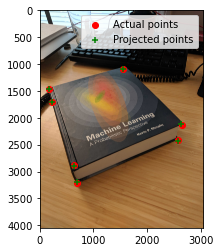

In [27]:
P1 = projection_matrix.estimate_camera_matrix(points_2d, points_3d, initial_guess_P)
print('The projection matrix is\n', P1)

[projected_2d_pts, residual] = evaluate_points(P1, points_2d, points_3d);
print('The total residual is {:f}'.format(residual))
visualize_points_image(points_2d, projected_2d_pts, image1_path)

**TODO:** copy this image to the report (Slide 5, left)

*Repeat for image 2.*

In [28]:
# set the pats and load the data
pts2d_path = '../data/pts2d_image2.npy'
pts3d_path = '../data/pts3d_fiducial.npy'

points_2d = np.loadtxt(pts2d_path)
points_3d = np.loadtxt(pts3d_path)
img = load_image(image1_path)
np.array(img.shape[:2])/2

array([2024., 1518.])

In [29]:
initial_guess_K = np.array([[ 500,   0, 2024],
                            [   0, 500, 1518],
                            [   0,   0,  1]])

initial_guess_R_T = np.array([[ 0.5,   -1,  0],
                            [   0,    0, -1],
                            [   1,  0.5,  -0.5]])

initial_guess_t = np.array([-30, -10, 30]).reshape(3, 1)

initial_guess_I_t = np.hstack((np.eye(3), initial_guess_t))

initial_guess_P = np.matmul(initial_guess_K, np.matmul(initial_guess_R_T, initial_guess_I_t))

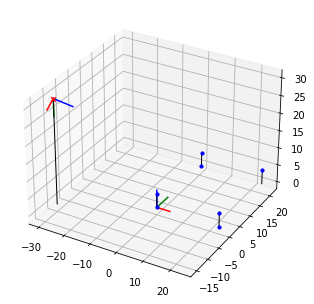

In [30]:
plot3dview_with_coordinates(points_3d, initial_guess_I_t[:,3], initial_guess_R_T.T) #change this plot to show the world coordinate system better

**TODO:** copy this image to the report (Slide 4, right)

[[2356. 3210.]
 [ 154. 2169.]
 [2794. 1884.]
 [2487. 2902.]
 [  90. 1873.]
 [1140. 1073.]
 [2859. 1577.]]
[[ 0.   0.   0. ]
 [23.5  0.   0. ]
 [ 0.  21.   0. ]
 [ 0.   0.   4. ]
 [23.5  0.   4. ]
 [23.5 21.   4. ]
 [ 0.  21.   4. ]]
[[   2274.      512.    -1012.  -103700. ]
 [   1518.      759.    -1259.   -90900. ]
 [      1.        0.5      -0.5       1. ]]
[[ 0.   0.   0. ]
 [23.5  0.   0. ]
 [ 0.  21.   0. ]
 [ 0.   0.   4. ]
 [23.5  0.   4. ]
 [23.5 21.   4. ]
 [ 0.  21.   4. ]]
[[ 0.  23.5  0.   0.  23.5 23.5  0. ]
 [ 0.   0.  21.   0.   0.  21.  21. ]
 [ 0.   0.   0.   4.   4.   4.   4. ]
 [ 1.   1.   1.   1.   1.   1.   1. ]]
[[-103700.           -2051.46938776   -8082.43478261  107748.
    -2413.73333333   -1319.90909091  -10210.10526316]
 [ -90900.           -2254.16326531   -6518.34782609   95936.
    -2678.35555556   -1343.15151515   -8420.73684211]]
[[2356. 3210.]
 [ 154. 2169.]
 [2794. 1884.]
 [2487. 2902.]
 [  90. 1873.]
 [1140. 1073.]
 [2859. 1577.]]
[[ 0.   0.   0. ]


  1583.48076839 1459.42074914]]
[[2356. 3210.]
 [ 154. 2169.]
 [2794. 1884.]
 [2487. 2902.]
 [  90. 1873.]
 [1140. 1073.]
 [2859. 1577.]]
[[ 0.   0.   0. ]
 [23.5  0.   0. ]
 [ 0.  21.   0. ]
 [ 0.   0.   4. ]
 [23.5  0.   4. ]
 [23.5 21.   4. ]
 [ 0.  21.   4. ]]
[[ -39.5713577   484.50592082 -390.84300515 2351.14017384]
 [ 328.10132252  222.37792746 -585.68791884 3265.35081037]
 [   0.19442705    0.16723308   -0.16996763    1.        ]]
[[ 0.   0.   0. ]
 [23.5  0.   0. ]
 [ 0.  21.   0. ]
 [ 0.   0.   4. ]
 [23.5  0.   4. ]
 [23.5 21.   4. ]
 [ 0.  21.   4. ]]
[[ 0.  23.5  0.   0.  23.5 23.5  0. ]
 [ 0.   0.  21.   0.   0.  21.  21. ]
 [ 0.   0.   0.   4.   4.   4.   4. ]
 [ 1.   1.   1.   1.   1.   1.   1. ]]
[[2351.14017384  255.19916855 2776.16508613 2460.77964533  -29.07628364
  1194.19046828 2860.73154851]
 [3265.35081037 1970.84963644 1758.74833792 2881.95602084 1765.7370838
  1583.48076839 1459.42074914]]
[[2356. 3210.]
 [ 154. 2169.]
 [2794. 1884.]
 [2487. 2902.]
 [  90. 187

 [ 0.  21.   4. ]]
[[ -92.21424932   86.95786175  -22.59822184 2364.92223794]
 [ -18.77666483  -18.78929089 -137.85405914 3213.43618844]
 [   0.01162768    0.02419926   -0.02049118    1.        ]]
[[ 0.   0.   0. ]
 [23.5  0.   0. ]
 [ 0.  21.   0. ]
 [ 0.   0.   4. ]
 [23.5  0.   4. ]
 [23.5 21.   4. ]
 [ 0.  21.   4. ]]
[[ 0.  23.5  0.   0.  23.5 23.5  0. ]
 [ 0.   0.  21.   0.   0.  21.  21. ]
 [ 0.   0.   0.   4.   4.   4.   4. ]
 [ 1.   1.   1.   1.   1.   1.   1. ]]
[[2364.92223794  155.41905806 2778.86271966 2477.60556376   90.23401483
  1137.77207154 2875.18433354]
 [3213.43618844 2177.25009156 1869.04275499 2899.69238778 1864.17777696
  1074.56626985 1589.82861693]]
[[2356. 3210.]
 [ 154. 2169.]
 [2794. 1884.]
 [2487. 2902.]
 [  90. 1873.]
 [1140. 1073.]
 [2859. 1577.]]
[[ 0.   0.   0. ]
 [23.5  0.   0. ]
 [ 0.  21.   0. ]
 [ 0.   0.   4. ]
 [23.5  0.   4. ]
 [23.5 21.   4. ]
 [ 0.  21.   4. ]]
[[ -92.21424932   86.95786175  -22.59822184 2364.92223794]
 [ -18.77643742  -18.789

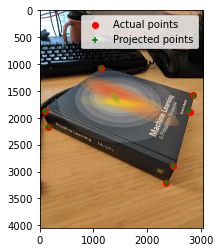

In [31]:
P2 = projection_matrix.estimate_camera_matrix(points_2d, points_3d, initial_guess_P)
#M = sc.calculate_projection_matrix(points_2d, points_3d)
print('The projection matrix is\n', P2)

[projected_2d_pts, residual] = evaluate_points(P2, points_2d, points_3d);
print('The total residual is {:f}'.format(residual))
visualize_points_image(points_2d, projected_2d_pts, image2_path)
#visualize_points(points_2d, projected_2d_pts)

**TODO:** copy this image to the report (Slide 5, right)

## Part 2.3 Visualizing both camera poses in the world coordinate system

[[-0.0033339  -0.00408834 36.7131615 ]
 [ 0.00851749 -0.00205085  3.23488462]
 [-0.00057983 -0.00715851 -7.45701353]]
[ 694.52174294 3197.25389563    1.        ]
[-21.32623164  -2.59338898  30.74730392]
[[-0.00728689 -0.00241855 24.30692252]
 [ 0.00389252 -0.00421499 24.06348928]
 [ 0.00046197 -0.00635013 -6.59056454]]
[2364.92223794 3213.43618844    1.        ]
[  0.69785339 -19.72439257  25.90377302]


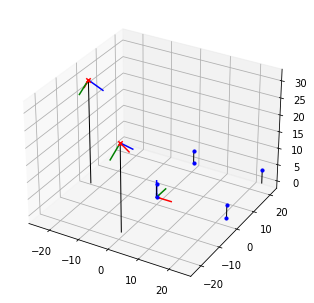

In [32]:
K1, R1 = projection_matrix.decompose_camera_matrix(P1)
center_1 = projection_matrix.calculate_camera_center(P1, K1, R1);
print(center_1)

K2, R2 = projection_matrix.decompose_camera_matrix(P2)
center_2 = projection_matrix.calculate_camera_center(P2, K2, R2);
print(center_2)

plot3dview_2_cameras(points_3d, center_1, center_2, R1.T, R2.T)

**TODO:** Copy this plot to the report (Slide 6)

# Part 3 Fundamental Matrix Estimation

In this part you'll be estimating the fundamental matrix. You'll be using a least squares optimizer from SciPy. (Documentation here: https://docs.scipy.org/doc/scipy/reference/generated/scipy.optimize.least_squares.html)

The least squares optimizer takes an objective function, your variables to optimize, and the points that you want to fit your model to. In this case, the objective function is to minimize the point to line distance, where the line is the projection of a point onto another image by the fundamental matrix, and the point is an actual point of a feature in that image. The variable that you want to optimize would be the 9 values in the 3x3 Fundamental Matrix. The points that you are optimizing over are provided to you, and they are the homogeneous coordinates of corresponding features from two different images of the same scene.

## Part 3.1 Distance computation

We will first write a function to compute distance of 2D point from 2D line.

\begin{align}
    d(line=[a, b, c], point = [u, v, w=1]) = \frac{au + bv + c}{\sqrt{a^2 + b^2}}
\end{align}

**TODO:** implement `point_line_distance` in `fundamental_matrix.py`

In [36]:
from proj2_unit_tests.test_fundamental_matrix import verify
from proj2_unit_tests.test_fundamental_matrix import TestFundamentalMatrix

test_fundamental_matrix_stereo = TestFundamentalMatrix()
TestFundamentalMatrix.setUp(test_fundamental_matrix_stereo)
print("test_point_line_distance(): " + verify(test_fundamental_matrix_stereo.test_point_line_distance))
print("test_point_line_distance_zero(): " + verify(test_fundamental_matrix_stereo.test_point_line_distance_zero))

test_point_line_distance(): "Correct"
test_point_line_distance_zero(): "Correct"


We will now use the point-line distance function to compute the symmetric epipolar error between measurements $x_0$ and $x_1$ of the same 3D point under 2 cameras. The two cameras are related by fundamental matrix $F$.

$F x_1$ gives the epipolar line in camera 0, and $x_0$ should ideally lie on this line. Similarly, $F^T x_0$ is the epipolar line in camera 1.

The symmetric epipolar error is computed as:
\begin{align}
    \color{red}{d(Fx_1, x_0)}^2 + \color{red}{d(F^T x_0, x_1)}^2
\end{align}

In actual images, we will have multiple $(x_0 x_1)$s between two images. Hence you will implement a function to compute the symmetric error for a list of points. Keep in mind that SciPy does the squaring and summing for you, so all you have to do in `signed_point_line_errors()` is return a list of each individual error. So if there are 9 points, you have to calculate the `point_line_distance()` between each pair from $Fx_1$ to $x_0$ and also $F^Tx_0$ to $x_1$, then append all errors to a list, such that you end up returning a list of length 18. 

SciPy will take the list and square each element and sum everything for you. The red parts in the equation below are the parts you'll need to implement.


**TODO:** Implement `signed_point_line_errors()` in `fundamental_matrix.py`.

In [37]:
from proj2_unit_tests.test_fundamental_matrix import TestFundamentalMatrix2, TestFundamentalMatrix3

print("TestFundamentalMatrix():")
print("test_signed_point_line_errors(): " + verify(test_fundamental_matrix_stereo.test_signed_point_line_errors))

print("TestFundamentalMatrix2():")
test_fundamental_matrix_synthetic = TestFundamentalMatrix2()
TestFundamentalMatrix2.setUp(test_fundamental_matrix_synthetic)
print("test_signed_point_line_errors(): " + verify(test_fundamental_matrix_synthetic.test_signed_point_line_errors))

print("TestFundamentalMatrix3():")
test_fundamental_matrix_real = TestFundamentalMatrix3()
TestFundamentalMatrix3.setUp(test_fundamental_matrix_real)
print("test_signed_point_line_errors(): " + verify(test_fundamental_matrix_real.test_signed_point_line_errors))

TestFundamentalMatrix():
[[100, 200, 1], [100, 140, 1], [200, 240, 1], [300, 340, 1], [200, 440, 1], [100, 480, 1], [300, 340, 1], [300, 440, 1], [500, 100, 1]]
9
test_signed_point_line_errors(): "Correct"
TestFundamentalMatrix2():
[array([104.90818316, 240.        ,   1.        ]), array([-130.54925564,   60.19401592,    1.        ]), array([ 19.70378342, 134.74549707,   1.        ]), array([-130.54925564,  419.80598408,    1.        ]), array([ 19.70378342, 345.25450293,   1.        ]), array([234.30234398,  80.15710315,   1.        ]), array([233.34960883, 141.91629937,   1.        ]), array([234.30234398, 399.84289685,   1.        ]), array([233.34960883, 338.08370063,   1.        ])]
9
test_signed_point_line_errors(): "Correct"
TestFundamentalMatrix3():
[[211, 184, 1], [190, 257, 1], [231, 319, 1], [198, 397, 1], [181, 569, 1], [316, 513, 1], [113, 270, 1], [140, 213, 1], [244, 180, 1], [158, 319, 1]]
10
test_signed_point_line_errors(): "Correct"


## Part 3.2: Optimization for F

We have all the components ready to construct an objective function for F and perform optimization. As we have a least-squares problem, you will need to use [Scipy's least square optimization](https://docs.scipy.org/doc/scipy/reference/generated/scipy.optimize.least_squares.html#scipy.optimize.least_squares) function. More information is provided in the function docstring. 

**TODO:** complete the `optimize` function in `least_squares_fundamental_matrix.py`.

In [38]:
print("test_least_squares_optimize() stereo: " + verify(test_fundamental_matrix_stereo.test_least_squares_optimize))
print("test_least_squares_optimize() synthetic: " + verify(test_fundamental_matrix_synthetic.test_least_squares_optimize))
print("test_least_squares_optimize() real: " + verify(test_fundamental_matrix_real.test_least_squares_optimize))

[[100 200   1]
 [100 140   1]
 [200 240   1]
 [300 340   1]
 [200 440   1]
 [100 480   1]
 [300 340   1]
 [300 440   1]
 [500 100   1]]
9
[[100 200   1]
 [100 140   1]
 [200 240   1]
 [300 340   1]
 [200 440   1]
 [100 480   1]
 [300 340   1]
 [300 440   1]
 [500 100   1]]
9
[[100 200   1]
 [100 140   1]
 [200 240   1]
 [300 340   1]
 [200 440   1]
 [100 480   1]
 [300 340   1]
 [300 440   1]
 [500 100   1]]
9
[[100 200   1]
 [100 140   1]
 [200 240   1]
 [300 340   1]
 [200 440   1]
 [100 480   1]
 [300 340   1]
 [300 440   1]
 [500 100   1]]
9
[[100 200   1]
 [100 140   1]
 [200 240   1]
 [300 340   1]
 [200 440   1]
 [100 480   1]
 [300 340   1]
 [300 440   1]
 [500 100   1]]
9
[[100 200   1]
 [100 140   1]
 [200 240   1]
 [300 340   1]
 [200 440   1]
 [100 480   1]
 [300 340   1]
 [300 440   1]
 [500 100   1]]
9
[[100 200   1]
 [100 140   1]
 [200 240   1]
 [300 340   1]
 [200 440   1]
 [100 480   1]
 [300 340   1]
 [300 440   1]
 [500 100   1]]
9
[[100 200   1]
 [100 140   1]
 [20

Run the following cell to find the Fundamental Matrix using least squares. You should see the epipolar lines in the correct places in the image. **You'll need to screenshot this and put it in your report.**

[[880. 214.   1.]
 [ 43. 203.   1.]
 [270. 197.   1.]
 [886. 347.   1.]
 [745. 302.   1.]
 [943. 128.   1.]
 [476. 590.   1.]
 [419. 214.   1.]
 [317. 335.   1.]
 [783. 521.   1.]
 [235. 427.   1.]
 [665. 429.   1.]
 [655. 362.   1.]
 [427. 333.   1.]
 [412. 415.   1.]
 [746. 351.   1.]
 [434. 415.   1.]
 [525. 234.   1.]
 [716. 308.   1.]
 [602. 187.   1.]]
20
[[880. 214.   1.]
 [ 43. 203.   1.]
 [270. 197.   1.]
 [886. 347.   1.]
 [745. 302.   1.]
 [943. 128.   1.]
 [476. 590.   1.]
 [419. 214.   1.]
 [317. 335.   1.]
 [783. 521.   1.]
 [235. 427.   1.]
 [665. 429.   1.]
 [655. 362.   1.]
 [427. 333.   1.]
 [412. 415.   1.]
 [746. 351.   1.]
 [434. 415.   1.]
 [525. 234.   1.]
 [716. 308.   1.]
 [602. 187.   1.]]
20
[[880. 214.   1.]
 [ 43. 203.   1.]
 [270. 197.   1.]
 [886. 347.   1.]
 [745. 302.   1.]
 [943. 128.   1.]
 [476. 590.   1.]
 [419. 214.   1.]
 [317. 335.   1.]
 [783. 521.   1.]
 [235. 427.   1.]
 [665. 429.   1.]
 [655. 362.   1.]
 [427. 333.   1.]
 [412. 415.   1.]
 [

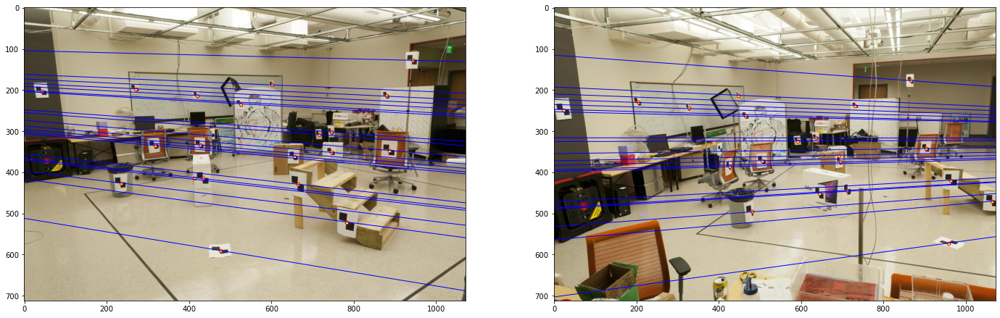

In [39]:
%matplotlib inline
# Load the data for room images
points_2d_pic_a = np.loadtxt('../data/pts2d-pic_a.txt')
points_2d_pic_b = np.loadtxt('../data/pts2d-pic_b.txt')
img_left = load_image('../data/pic_a.jpg')
img_right = load_image('../data/pic_b.jpg')

import least_squares_fundamental_matrix as ls

F = ls.solve_F(points_2d_pic_a, points_2d_pic_b)
print(F)

# Draw epipolar lines using the fundamental matrix
draw_epipolar_lines(F, img_left, img_right, points_2d_pic_a, points_2d_pic_b)

**TODO:** Copy the two images to the report (Slide 7)

## Part 3.3 Try Fundamental Matrix Estimation Yourself

Now you're going to take two images yourself and estimate the fundamental matrix between them. 

**TODO:** take two images and save them as "my_image_0.jpg" and "my_image_1.jpg" in the "/data" folder.

In [40]:
# Load the data for room images
my_img_left = load_image('../data/my_image_0.jpg')
my_img_right = load_image('../data/my_image_1.jpg')

To collect your own data points, run the following cell and mouse over corresponding features in both images and record the x- and y-coordinates. You'll need at least 9 points because we are trying to optimize for 9 variables, one for each element in the 3x3 fundamental matrix. Think about how you can choose good features for estimating the fundamental matrix.

**TODO:** Store your points in variable "my_image_0_pts" and "my_image_1_pts" respectively.

In [ ]:
# it's known to have problem (showing blank plot) when switching from `matplotlib inline` 
# to `matplotlib notebook`, and calling `matplotlib notebook` twice can resolve that
# in some cases. 
# refer: https://stackoverflow.com/questions/41125690/matplotlib-notebook-showing-a-blank-histogram?noredirect=1&lq=1
%matplotlib notebook
%matplotlib notebook
# plotting image 1
image_0 = plt.figure(); image_0_ax = image_0.add_subplot(111); image_0_ax.imshow(my_img_left)

In [ ]:
my_image_0_pts = np.array([[ 669, 1193],
                           [1377, 2031],
                           [2948, 1806],
                           [2310,  498],
                           [3132, 2056],
                           [ 317, 1680],
                           [2289, 1295],
                           [2559, 1516],
                           [1880, 1618]]) # Record your coordinates here

In [ ]:
# it's known to have problem (showing blank plot) when switching from `matplotlib inline` 
# to `matplotlib notebook`, and calling `matplotlib notebook` twice can resolve that
# in some cases. 
# refer: https://stackoverflow.com/questions/41125690/matplotlib-notebook-showing-a-blank-histogram?noredirect=1&lq=1
%matplotlib notebook
%matplotlib notebook
# plotting image 2
image_1 = plt.figure(); image_1_ax = image_1.add_subplot(111); image_1_ax.imshow(my_img_right)

In [ ]:
my_image_1_pts = np.array([[ 555, 1336],
                           [ 436, 1786],
                           [2567, 2158],
                           [2478,  870],
                           [2973, 2502],
                           [ 289, 1533],
                           [2265, 1581],
                           [2175, 1774],
                           [1561, 1737]]) # Record your coordinates here

In [ ]:
%matplotlib inline
import two_view_data as two_view_data
my_F = ls.solve_F(my_image_0_pts, my_image_1_pts)
print(my_F)

# Draw epipolar lines using the fundamental matrix
draw_epipolar_lines(my_F, my_img_left, my_img_right, my_image_0_pts, my_image_1_pts)

**TODO:** Check if the epipoles are roughly where your camera position was

## Part 3.4: Reflection Questions

**TODO:** _Put these answers in your report!_ (Slide 9 and 10, dont use extra slide)
1. Why is it that when you take your own images, you can't just rotate the camera or zoom the image for your two images of the same scene?
2. Why is it that points in one image are projected by the fundamental matrix onto epipolar *lines* in the other image?
3. What happens to the epipoles and epipolar lines when you take two images where the camera centers are within the images? Why?
4. What does it mean when your epipolar lines are all horizontal across the two images?
5. Why is the fundamental matrix defined up to a scale?
6. Why is the fundamental matrix rank 2?

# Part 4: Fundamental Matrix with RANSAC (Szeliski 6.1.4)

In the previous section, you marked the correspondences manually. In real world applications, we will use algorithms to detect and match points of interest between images. These methods will have outliers, ranging from a small percentage to even more than 50%. 

Now, we will load two images, and their point correspondences. The correspondences have 90% accuracy.

In [41]:
# Notre Dame images
image0 = load_image('../data/IMG_4407.jpeg')
image1 = load_image('../data/IMG_0788.jpeg')

In [42]:
# load the pre-computed correspondences
# The first row of pts1 matches with first row of pts2.
pts0 = np.loadtxt('../data/pts_a.txt')
pts1 = np.loadtxt('../data/pts_b.txt')

print('Number of matches loaded = ', pts1.shape[0])

Number of matches loaded =  162


Randomly visualizing a subset of matches

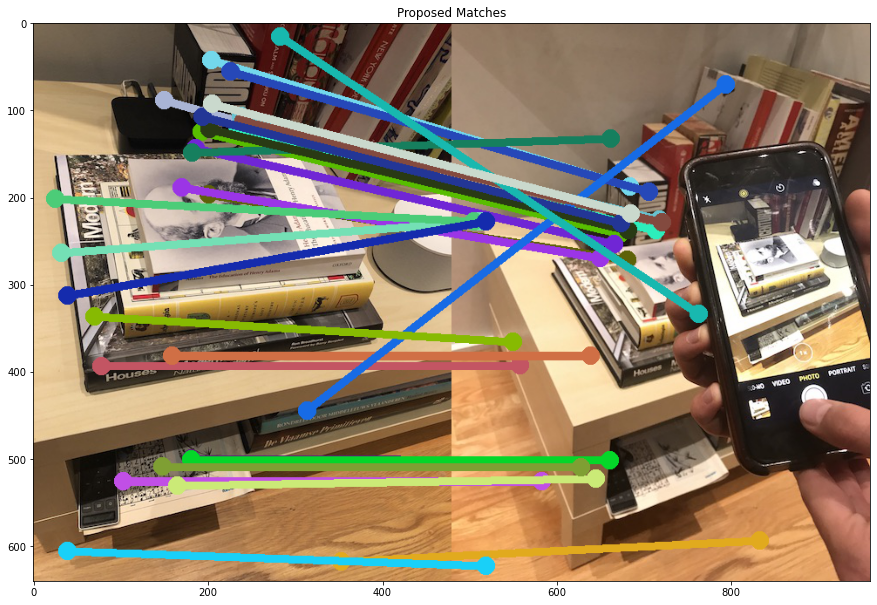

In [43]:
from feature_matching.utils import show_correspondence_lines


num_pts_to_visualize = 30
num_pts_total = min(pts0.shape[0], pts1.shape[0])
pts_to_viz = np.random.choice(np.arange(num_pts_total), num_pts_to_visualize, replace=False)

c2 = show_correspondence_lines(image0, image1,
                    pts0[pts_to_viz, 0], pts0[pts_to_viz, 1],
                    pts0[pts_to_viz, 0], pts1[pts_to_viz, 1],)
plt.figure(figsize=(15,20)) 
plt.title('Proposed Matches')
plt.imshow(c2)

You'll notice some outlier correspondences. If you do not, please run the cell again and the new random subset might have outliers.

Let's run our fundamental matrix estimator on this input which has outliers

[[ 25.00209808 201.99337769   1.        ]
 [ 32.48091125 263.78210449   1.        ]
 [ 37.01263809 298.65594482   1.        ]
 [ 39.18016815 312.75823975   1.        ]
 [ 39.5221405  605.10235596   1.        ]
 [ 40.42342377 604.0814209    1.        ]
 [ 55.07818604 237.41725159   1.        ]
 [ 56.39440918 357.01589966   1.        ]
 [ 57.84542084 262.97399902   1.        ]
 [ 58.2983284  165.97567749   1.        ]
 [ 58.50378036 172.68130493   1.        ]
 [ 59.10093307 154.60522461   1.        ]
 [ 61.21952057 243.33798218   1.        ]
 [ 63.34880066 212.66227722   1.        ]
 [ 63.71529007 295.23748779   1.        ]
 [ 67.10639191 348.87753296   1.        ]
 [ 70.13082123 336.93371582   1.        ]
 [ 71.35778809 363.54901123   1.        ]
 [ 71.78093719 409.60015869   1.        ]
 [ 72.82126617 330.60635376   1.        ]
 [ 75.46218872 553.41070557   1.        ]
 [ 75.46218872 553.41070557   1.        ]
 [ 75.5402298  354.77246094   1.        ]
 [ 77.3986969  360.93664551   1.  

[[ 25.00209808 201.99337769   1.        ]
 [ 32.48091125 263.78210449   1.        ]
 [ 37.01263809 298.65594482   1.        ]
 [ 39.18016815 312.75823975   1.        ]
 [ 39.5221405  605.10235596   1.        ]
 [ 40.42342377 604.0814209    1.        ]
 [ 55.07818604 237.41725159   1.        ]
 [ 56.39440918 357.01589966   1.        ]
 [ 57.84542084 262.97399902   1.        ]
 [ 58.2983284  165.97567749   1.        ]
 [ 58.50378036 172.68130493   1.        ]
 [ 59.10093307 154.60522461   1.        ]
 [ 61.21952057 243.33798218   1.        ]
 [ 63.34880066 212.66227722   1.        ]
 [ 63.71529007 295.23748779   1.        ]
 [ 67.10639191 348.87753296   1.        ]
 [ 70.13082123 336.93371582   1.        ]
 [ 71.35778809 363.54901123   1.        ]
 [ 71.78093719 409.60015869   1.        ]
 [ 72.82126617 330.60635376   1.        ]
 [ 75.46218872 553.41070557   1.        ]
 [ 75.46218872 553.41070557   1.        ]
 [ 75.5402298  354.77246094   1.        ]
 [ 77.3986969  360.93664551   1.  

[[ 25.00209808 201.99337769   1.        ]
 [ 32.48091125 263.78210449   1.        ]
 [ 37.01263809 298.65594482   1.        ]
 [ 39.18016815 312.75823975   1.        ]
 [ 39.5221405  605.10235596   1.        ]
 [ 40.42342377 604.0814209    1.        ]
 [ 55.07818604 237.41725159   1.        ]
 [ 56.39440918 357.01589966   1.        ]
 [ 57.84542084 262.97399902   1.        ]
 [ 58.2983284  165.97567749   1.        ]
 [ 58.50378036 172.68130493   1.        ]
 [ 59.10093307 154.60522461   1.        ]
 [ 61.21952057 243.33798218   1.        ]
 [ 63.34880066 212.66227722   1.        ]
 [ 63.71529007 295.23748779   1.        ]
 [ 67.10639191 348.87753296   1.        ]
 [ 70.13082123 336.93371582   1.        ]
 [ 71.35778809 363.54901123   1.        ]
 [ 71.78093719 409.60015869   1.        ]
 [ 72.82126617 330.60635376   1.        ]
 [ 75.46218872 553.41070557   1.        ]
 [ 75.46218872 553.41070557   1.        ]
 [ 75.5402298  354.77246094   1.        ]
 [ 77.3986969  360.93664551   1.  

[[ 25.00209808 201.99337769   1.        ]
 [ 32.48091125 263.78210449   1.        ]
 [ 37.01263809 298.65594482   1.        ]
 [ 39.18016815 312.75823975   1.        ]
 [ 39.5221405  605.10235596   1.        ]
 [ 40.42342377 604.0814209    1.        ]
 [ 55.07818604 237.41725159   1.        ]
 [ 56.39440918 357.01589966   1.        ]
 [ 57.84542084 262.97399902   1.        ]
 [ 58.2983284  165.97567749   1.        ]
 [ 58.50378036 172.68130493   1.        ]
 [ 59.10093307 154.60522461   1.        ]
 [ 61.21952057 243.33798218   1.        ]
 [ 63.34880066 212.66227722   1.        ]
 [ 63.71529007 295.23748779   1.        ]
 [ 67.10639191 348.87753296   1.        ]
 [ 70.13082123 336.93371582   1.        ]
 [ 71.35778809 363.54901123   1.        ]
 [ 71.78093719 409.60015869   1.        ]
 [ 72.82126617 330.60635376   1.        ]
 [ 75.46218872 553.41070557   1.        ]
 [ 75.46218872 553.41070557   1.        ]
 [ 75.5402298  354.77246094   1.        ]
 [ 77.3986969  360.93664551   1.  

[[ 25.00209808 201.99337769   1.        ]
 [ 32.48091125 263.78210449   1.        ]
 [ 37.01263809 298.65594482   1.        ]
 [ 39.18016815 312.75823975   1.        ]
 [ 39.5221405  605.10235596   1.        ]
 [ 40.42342377 604.0814209    1.        ]
 [ 55.07818604 237.41725159   1.        ]
 [ 56.39440918 357.01589966   1.        ]
 [ 57.84542084 262.97399902   1.        ]
 [ 58.2983284  165.97567749   1.        ]
 [ 58.50378036 172.68130493   1.        ]
 [ 59.10093307 154.60522461   1.        ]
 [ 61.21952057 243.33798218   1.        ]
 [ 63.34880066 212.66227722   1.        ]
 [ 63.71529007 295.23748779   1.        ]
 [ 67.10639191 348.87753296   1.        ]
 [ 70.13082123 336.93371582   1.        ]
 [ 71.35778809 363.54901123   1.        ]
 [ 71.78093719 409.60015869   1.        ]
 [ 72.82126617 330.60635376   1.        ]
 [ 75.46218872 553.41070557   1.        ]
 [ 75.46218872 553.41070557   1.        ]
 [ 75.5402298  354.77246094   1.        ]
 [ 77.3986969  360.93664551   1.  

[[ 25.00209808 201.99337769   1.        ]
 [ 32.48091125 263.78210449   1.        ]
 [ 37.01263809 298.65594482   1.        ]
 [ 39.18016815 312.75823975   1.        ]
 [ 39.5221405  605.10235596   1.        ]
 [ 40.42342377 604.0814209    1.        ]
 [ 55.07818604 237.41725159   1.        ]
 [ 56.39440918 357.01589966   1.        ]
 [ 57.84542084 262.97399902   1.        ]
 [ 58.2983284  165.97567749   1.        ]
 [ 58.50378036 172.68130493   1.        ]
 [ 59.10093307 154.60522461   1.        ]
 [ 61.21952057 243.33798218   1.        ]
 [ 63.34880066 212.66227722   1.        ]
 [ 63.71529007 295.23748779   1.        ]
 [ 67.10639191 348.87753296   1.        ]
 [ 70.13082123 336.93371582   1.        ]
 [ 71.35778809 363.54901123   1.        ]
 [ 71.78093719 409.60015869   1.        ]
 [ 72.82126617 330.60635376   1.        ]
 [ 75.46218872 553.41070557   1.        ]
 [ 75.46218872 553.41070557   1.        ]
 [ 75.5402298  354.77246094   1.        ]
 [ 77.3986969  360.93664551   1.  

[[ 25.00209808 201.99337769   1.        ]
 [ 32.48091125 263.78210449   1.        ]
 [ 37.01263809 298.65594482   1.        ]
 [ 39.18016815 312.75823975   1.        ]
 [ 39.5221405  605.10235596   1.        ]
 [ 40.42342377 604.0814209    1.        ]
 [ 55.07818604 237.41725159   1.        ]
 [ 56.39440918 357.01589966   1.        ]
 [ 57.84542084 262.97399902   1.        ]
 [ 58.2983284  165.97567749   1.        ]
 [ 58.50378036 172.68130493   1.        ]
 [ 59.10093307 154.60522461   1.        ]
 [ 61.21952057 243.33798218   1.        ]
 [ 63.34880066 212.66227722   1.        ]
 [ 63.71529007 295.23748779   1.        ]
 [ 67.10639191 348.87753296   1.        ]
 [ 70.13082123 336.93371582   1.        ]
 [ 71.35778809 363.54901123   1.        ]
 [ 71.78093719 409.60015869   1.        ]
 [ 72.82126617 330.60635376   1.        ]
 [ 75.46218872 553.41070557   1.        ]
 [ 75.46218872 553.41070557   1.        ]
 [ 75.5402298  354.77246094   1.        ]
 [ 77.3986969  360.93664551   1.  

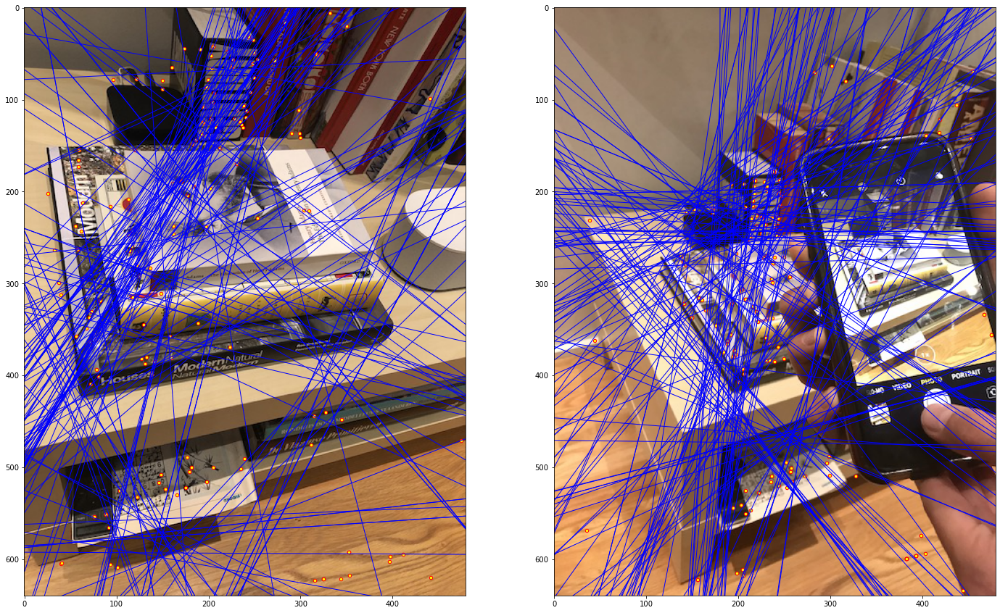

In [44]:
my_F = ls.solve_F(pts0, pts1)
print(my_F)

# Draw epipolar lines using the fundamental matrix
draw_epipolar_lines(my_F, image0, image1, pts0, pts1)

The result will be pretty bad. 

We had a large number of correspondences, but they had some outliers. This is where RANSAC comes into picture. RANSAC can be robust to a very large percentage of outliers.

**Brief algorithm:**

In each iteration, RANSAC will select a random subset of those points:
1. Call your function from part 3 to calculate the fundamental matrix for the random subset
2. Check how many interest points (from the full input, not the subset) are inliers according to this fundamental matrix.

Repeat the process, and in the end, keep the F matrix which had the maximum number of matches as inliers. 

Refer to the lecture slides for the RANSAC workflow. You can also find a simple explanation of RANSAC at 
https://www.mathworks.com/discovery/ransac.html. See section 6.1.4 in the textbook for a more thorough explanation of how RANSAC works.

Keep in mind that although the fundamental matrix does not normally have 9 degrees of freedom, the way we are performing the optimization in part 2 does not enforce any constraints on the matrix, and so we need 9 point correspondences to perform the optimization for the 9 variables.


## Part 4.1: RANSAC Iterations

Begin by calculating the number of iterations $S$ RANSAC will need to perform to guarentee a given success rate $P$ knowing the number of points included in the sample $k$ and the probability of an individual point being a true match $p$. To derive this formula, consider the following:
 * the probability that any one point has a true match is $p$
  * conversely the probability that any one point is not a correct match is $1-p$
  * the probability that two points are both matches is then $p \cdot p$
  * this can be extendeed to $k$ points, for which the probability that they are all true matches is $p^k$
 * on the other hand, we want the probability that $k$ points are all true matches to be $P$ (and the probability that they are not to be $1-P$)
 * by repeatedly sampling $k$ points, we can reduce the probability that none of the samples contain $k$ true matches
 * After $S$ iteration, we want to get atleast one iteration where the samples are all inliers. To compute this, we can compute the probability that we had no iteration with a perfect sample. That has to be equal to $1-P$.
 
Start by setting up this equality $$1-P = ...$$
and then rearange it to write a function to solve for $S$

**TODO:** Use the derivation to complete function `calculate_num_ransac_iterations` in `ransac.py`

In [62]:
from ransac import calculate_num_ransac_iterations
from proj2_unit_tests.test_ransac import test_calculate_num_ransac_iterations

P = 0.999
k = 9
p = 0.70
# call their ransac iterations function
S = calculate_num_ransac_iterations(P, k, p)
# print number of trials they will need to run
print('S =', int(S))

print("Test for calculate_num_ransac_iterations(): " + verify(test_calculate_num_ransac_iterations))

S = 167
Test for calculate_num_ransac_iterations(): "Correct"


## Part 4.2 Reflection Questions
**TODO**: put these answers in your report (Slide 11)

1. What is the **minimum** number of RANSAC iterations we would we need to find the fundamental matrix with 99.9% certainty from a set of proposed matches that have a 90% point correspondence accuracy? *Keep in mind that we need at least 9 point correspondences for our optimization to find the fundamental matrix in part 2*

2. One might imagine that if we had more than 9 point correspondences, it would be better to use more of them to solve for the fundamental matrix. Investigate this by finding the number of RANSAC iterations you would need to run for the above situation with 18 points.

3. If our dataset had a lower point correspondence accuracy, say 70%, what is the minimum number of iterations needed to find the fundamental matrix with 99.9% certainty?

At the end of this assignment you will be performing RANSAC to find the fundamental matrix for an image pair, and you will want to keep these results in mind when deciding how many iterations to perform. For example, we have shown that you want to use the minimum number of points in order to make it easier to find a sample with no outliers. You will also want to keep the accuracy and probability of success in mind.

## Part 4.3: RANSAC Implementation for F matrix
Next we will implement the RANSAC algorithm. Remember the steps from the link above:
 1. Randomly selecting a subset (k=9) of the data set
 2. Fitting a model to the selected subset
 3. Determining the number of outliers
 4. Repeating steps 1-3 for a prescribed number of iterations

For the application of finding true point pair matches and using them to calculate the fundamental matrix, our subset of the data will be the minimum number of point pairs needed to calculate the fundamental matrix.
The model we are fitting is the fundamental matrix.
Outliers will be found by using the `point_line_distance()` error function from part 2 and thresholding with a certain margin of error.

**TODO:** Complete `ransac_fundamental_matrix()` and `find_inliers()` in `ransac.py`

In [52]:
from ransac import ransac_fundamental_matrix
from proj2_unit_tests import test_ransac

points_a = np.load('../data/pointsa.npy')
points_b = points_a

F, _, _ = ransac_fundamental_matrix(points_a, points_b)
print('F= ', F)

print("Test for ransac_find_inliers(): " + verify(test_ransac.test_ransac_find_inliers))
print("Test for ransac_fundamental_matrix(), F matches inliers: " + verify(test_ransac.test_ransac_fundamental_matrix_error))
print("Test for ransac_fundamental_matrix(), F matches all points: " + verify(test_ransac.test_ransac_fundamental_matrix_fit))

[[ 75. 901.   1.]
 [ 87. 692.   1.]
 [158. 571.   1.]
 [254. 863.   1.]
 [158. 571.   1.]
 [288. 925.   1.]
 [137. 526.   1.]
 [100. 708.   1.]
 [172. 785.   1.]]
9
[[ 75. 901.   1.]
 [ 87. 692.   1.]
 [158. 571.   1.]
 [254. 863.   1.]
 [158. 571.   1.]
 [288. 925.   1.]
 [137. 526.   1.]
 [100. 708.   1.]
 [172. 785.   1.]]
9
[[ 75. 901.   1.]
 [ 87. 692.   1.]
 [158. 571.   1.]
 [254. 863.   1.]
 [158. 571.   1.]
 [288. 925.   1.]
 [137. 526.   1.]
 [100. 708.   1.]
 [172. 785.   1.]]
9
[[ 75. 901.   1.]
 [ 87. 692.   1.]
 [158. 571.   1.]
 [254. 863.   1.]
 [158. 571.   1.]
 [288. 925.   1.]
 [137. 526.   1.]
 [100. 708.   1.]
 [172. 785.   1.]]
9
[[ 75. 901.   1.]
 [ 87. 692.   1.]
 [158. 571.   1.]
 [254. 863.   1.]
 [158. 571.   1.]
 [288. 925.   1.]
 [137. 526.   1.]
 [100. 708.   1.]
 [172. 785.   1.]]
9
[[ 75. 901.   1.]
 [ 87. 692.   1.]
 [158. 571.   1.]
 [254. 863.   1.]
 [158. 571.   1.]
 [288. 925.   1.]
 [137. 526.   1.]
 [100. 708.   1.]
 [172. 785.   1.]]
9
[[ 75. 901

[[227. 522.   1.]
 [123. 936.   1.]
 [361. 540.   1.]
 [244. 898.   1.]
 [ 99. 596.   1.]
 [382. 557.   1.]
 [244. 898.   1.]
 [390. 554.   1.]
 [251. 817.   1.]]
9
[[227. 522.   1.]
 [123. 936.   1.]
 [361. 540.   1.]
 [244. 898.   1.]
 [ 99. 596.   1.]
 [382. 557.   1.]
 [244. 898.   1.]
 [390. 554.   1.]
 [251. 817.   1.]]
9
[[227. 522.   1.]
 [123. 936.   1.]
 [361. 540.   1.]
 [244. 898.   1.]
 [ 99. 596.   1.]
 [382. 557.   1.]
 [244. 898.   1.]
 [390. 554.   1.]
 [251. 817.   1.]]
9
[[227. 522.   1.]
 [123. 936.   1.]
 [361. 540.   1.]
 [244. 898.   1.]
 [ 99. 596.   1.]
 [382. 557.   1.]
 [244. 898.   1.]
 [390. 554.   1.]
 [251. 817.   1.]]
9
[[227. 522.   1.]
 [123. 936.   1.]
 [361. 540.   1.]
 [244. 898.   1.]
 [ 99. 596.   1.]
 [382. 557.   1.]
 [244. 898.   1.]
 [390. 554.   1.]
 [251. 817.   1.]]
9
[[390. 554.   1.]
 [ 87. 692.   1.]
 [ 84. 407.   1.]
 [462. 398.   1.]
 [225. 877.   1.]
 [123. 936.   1.]
 [402. 591.   1.]
 [109. 802.   1.]
 [219. 866.   1.]
 [ 85. 855.  

[[682. 734.   1.]
 [273. 859.   1.]
 [372. 557.   1.]
 [682. 734.   1.]
 [609. 887.   1.]
 [137. 526.   1.]
 [123. 936.   1.]
 [566. 696.   1.]
 [213. 751.   1.]]
9
[[682. 734.   1.]
 [273. 859.   1.]
 [372. 557.   1.]
 [682. 734.   1.]
 [609. 887.   1.]
 [137. 526.   1.]
 [123. 936.   1.]
 [566. 696.   1.]
 [213. 751.   1.]]
9
[[682. 734.   1.]
 [273. 859.   1.]
 [372. 557.   1.]
 [682. 734.   1.]
 [609. 887.   1.]
 [137. 526.   1.]
 [123. 936.   1.]
 [566. 696.   1.]
 [213. 751.   1.]]
9
[[682. 734.   1.]
 [273. 859.   1.]
 [372. 557.   1.]
 [682. 734.   1.]
 [609. 887.   1.]
 [137. 526.   1.]
 [123. 936.   1.]
 [566. 696.   1.]
 [213. 751.   1.]]
9
[[682. 734.   1.]
 [273. 859.   1.]
 [372. 557.   1.]
 [682. 734.   1.]
 [609. 887.   1.]
 [137. 526.   1.]
 [123. 936.   1.]
 [566. 696.   1.]
 [213. 751.   1.]]
9
[[682. 734.   1.]
 [273. 859.   1.]
 [372. 557.   1.]
 [682. 734.   1.]
 [609. 887.   1.]
 [137. 526.   1.]
 [123. 936.   1.]
 [566. 696.   1.]
 [213. 751.   1.]]
9
[[390. 554

[[128. 139.   1.]
 [478. 521.   1.]
 [566. 696.   1.]
 [ 83. 486.   1.]
 [172. 489.   1.]
 [274. 734.   1.]
 [254. 863.   1.]
 [273. 859.   1.]
 [ 80. 545.   1.]]
9
[[128. 139.   1.]
 [478. 521.   1.]
 [566. 696.   1.]
 [ 83. 486.   1.]
 [172. 489.   1.]
 [274. 734.   1.]
 [254. 863.   1.]
 [273. 859.   1.]
 [ 80. 545.   1.]]
9
[[128. 139.   1.]
 [478. 521.   1.]
 [566. 696.   1.]
 [ 83. 486.   1.]
 [172. 489.   1.]
 [274. 734.   1.]
 [254. 863.   1.]
 [273. 859.   1.]
 [ 80. 545.   1.]]
9
[[128. 139.   1.]
 [478. 521.   1.]
 [566. 696.   1.]
 [ 83. 486.   1.]
 [172. 489.   1.]
 [274. 734.   1.]
 [254. 863.   1.]
 [273. 859.   1.]
 [ 80. 545.   1.]]
9
[[128. 139.   1.]
 [478. 521.   1.]
 [566. 696.   1.]
 [ 83. 486.   1.]
 [172. 489.   1.]
 [274. 734.   1.]
 [254. 863.   1.]
 [273. 859.   1.]
 [ 80. 545.   1.]]
9
[[128. 139.   1.]
 [478. 521.   1.]
 [566. 696.   1.]
 [ 83. 486.   1.]
 [172. 489.   1.]
 [274. 734.   1.]
 [254. 863.   1.]
 [273. 859.   1.]
 [ 80. 545.   1.]]
9
[[128. 139

[[348. 500.   1.]
 [389. 507.   1.]
 [138. 192.   1.]
 [181. 524.   1.]
 [645. 860.   1.]
 [137. 526.   1.]
 [219. 501.   1.]
 [190. 416.   1.]
 [167. 110.   1.]]
9
[[348. 500.   1.]
 [389. 507.   1.]
 [138. 192.   1.]
 [181. 524.   1.]
 [645. 860.   1.]
 [137. 526.   1.]
 [219. 501.   1.]
 [190. 416.   1.]
 [167. 110.   1.]]
9
[[348. 500.   1.]
 [389. 507.   1.]
 [138. 192.   1.]
 [181. 524.   1.]
 [645. 860.   1.]
 [137. 526.   1.]
 [219. 501.   1.]
 [190. 416.   1.]
 [167. 110.   1.]]
9
[[348. 500.   1.]
 [389. 507.   1.]
 [138. 192.   1.]
 [181. 524.   1.]
 [645. 860.   1.]
 [137. 526.   1.]
 [219. 501.   1.]
 [190. 416.   1.]
 [167. 110.   1.]]
9
[[348. 500.   1.]
 [389. 507.   1.]
 [138. 192.   1.]
 [181. 524.   1.]
 [645. 860.   1.]
 [137. 526.   1.]
 [219. 501.   1.]
 [190. 416.   1.]
 [167. 110.   1.]]
9
[[348. 500.   1.]
 [389. 507.   1.]
 [138. 192.   1.]
 [181. 524.   1.]
 [645. 860.   1.]
 [137. 526.   1.]
 [219. 501.   1.]
 [190. 416.   1.]
 [167. 110.   1.]]
9
[[348. 500

[[348. 500.   1.]
 [389. 507.   1.]
 [138. 192.   1.]
 [181. 524.   1.]
 [645. 860.   1.]
 [137. 526.   1.]
 [219. 501.   1.]
 [190. 416.   1.]
 [167. 110.   1.]]
9
[[348. 500.   1.]
 [389. 507.   1.]
 [138. 192.   1.]
 [181. 524.   1.]
 [645. 860.   1.]
 [137. 526.   1.]
 [219. 501.   1.]
 [190. 416.   1.]
 [167. 110.   1.]]
9
[[348. 500.   1.]
 [389. 507.   1.]
 [138. 192.   1.]
 [181. 524.   1.]
 [645. 860.   1.]
 [137. 526.   1.]
 [219. 501.   1.]
 [190. 416.   1.]
 [167. 110.   1.]]
9
[[348. 500.   1.]
 [389. 507.   1.]
 [138. 192.   1.]
 [181. 524.   1.]
 [645. 860.   1.]
 [137. 526.   1.]
 [219. 501.   1.]
 [190. 416.   1.]
 [167. 110.   1.]]
9
[[348. 500.   1.]
 [389. 507.   1.]
 [138. 192.   1.]
 [181. 524.   1.]
 [645. 860.   1.]
 [137. 526.   1.]
 [219. 501.   1.]
 [190. 416.   1.]
 [167. 110.   1.]]
9
[[348. 500.   1.]
 [389. 507.   1.]
 [138. 192.   1.]
 [181. 524.   1.]
 [645. 860.   1.]
 [137. 526.   1.]
 [219. 501.   1.]
 [190. 416.   1.]
 [167. 110.   1.]]
9
[[348. 500

9
[[617. 542.   1.]
 [274. 734.   1.]
 [680. 425.   1.]
 [609. 887.   1.]
 [167. 405.   1.]
 [325. 781.   1.]
 [175. 582.   1.]
 [123. 936.   1.]
 [408. 558.   1.]]
9
[[617. 542.   1.]
 [274. 734.   1.]
 [680. 425.   1.]
 [609. 887.   1.]
 [167. 405.   1.]
 [325. 781.   1.]
 [175. 582.   1.]
 [123. 936.   1.]
 [408. 558.   1.]]
9
[[617. 542.   1.]
 [274. 734.   1.]
 [680. 425.   1.]
 [609. 887.   1.]
 [167. 405.   1.]
 [325. 781.   1.]
 [175. 582.   1.]
 [123. 936.   1.]
 [408. 558.   1.]]
9
[[617. 542.   1.]
 [274. 734.   1.]
 [680. 425.   1.]
 [609. 887.   1.]
 [167. 405.   1.]
 [325. 781.   1.]
 [175. 582.   1.]
 [123. 936.   1.]
 [408. 558.   1.]]
9
[[617. 542.   1.]
 [274. 734.   1.]
 [680. 425.   1.]
 [609. 887.   1.]
 [167. 405.   1.]
 [325. 781.   1.]
 [175. 582.   1.]
 [123. 936.   1.]
 [408. 558.   1.]]
9
[[617. 542.   1.]
 [274. 734.   1.]
 [680. 425.   1.]
 [609. 887.   1.]
 [167. 405.   1.]
 [325. 781.   1.]
 [175. 582.   1.]
 [123. 936.   1.]
 [408. 558.   1.]]
9
[[617. 5

[[170. 563.   1.]
 [408. 558.   1.]
 [682. 734.   1.]
 [123. 936.   1.]
 [244. 898.   1.]
 [355. 588.   1.]
 [205. 487.   1.]
 [180. 541.   1.]
 [ 99. 596.   1.]]
9
[[170. 563.   1.]
 [408. 558.   1.]
 [682. 734.   1.]
 [123. 936.   1.]
 [244. 898.   1.]
 [355. 588.   1.]
 [205. 487.   1.]
 [180. 541.   1.]
 [ 99. 596.   1.]]
9
[[170. 563.   1.]
 [408. 558.   1.]
 [682. 734.   1.]
 [123. 936.   1.]
 [244. 898.   1.]
 [355. 588.   1.]
 [205. 487.   1.]
 [180. 541.   1.]
 [ 99. 596.   1.]]
9
[[170. 563.   1.]
 [408. 558.   1.]
 [682. 734.   1.]
 [123. 936.   1.]
 [244. 898.   1.]
 [355. 588.   1.]
 [205. 487.   1.]
 [180. 541.   1.]
 [ 99. 596.   1.]]
9
[[170. 563.   1.]
 [408. 558.   1.]
 [682. 734.   1.]
 [123. 936.   1.]
 [244. 898.   1.]
 [355. 588.   1.]
 [205. 487.   1.]
 [180. 541.   1.]
 [ 99. 596.   1.]]
9
[[170. 563.   1.]
 [408. 558.   1.]
 [682. 734.   1.]
 [123. 936.   1.]
 [244. 898.   1.]
 [355. 588.   1.]
 [205. 487.   1.]
 [180. 541.   1.]
 [ 99. 596.   1.]]
9
[[170. 563

 [454. 540.   1.]]
9
[[109. 802.   1.]
 [147. 760.   1.]
 [ 81. 418.   1.]
 [682. 734.   1.]
 [216. 214.   1.]
 [333. 574.   1.]
 [264. 815.   1.]
 [105. 336.   1.]
 [454. 540.   1.]]
9
[[109. 802.   1.]
 [147. 760.   1.]
 [ 81. 418.   1.]
 [682. 734.   1.]
 [216. 214.   1.]
 [333. 574.   1.]
 [264. 815.   1.]
 [105. 336.   1.]
 [454. 540.   1.]]
9
[[109. 802.   1.]
 [147. 760.   1.]
 [ 81. 418.   1.]
 [682. 734.   1.]
 [216. 214.   1.]
 [333. 574.   1.]
 [264. 815.   1.]
 [105. 336.   1.]
 [454. 540.   1.]]
9
[[109. 802.   1.]
 [147. 760.   1.]
 [ 81. 418.   1.]
 [682. 734.   1.]
 [216. 214.   1.]
 [333. 574.   1.]
 [264. 815.   1.]
 [105. 336.   1.]
 [454. 540.   1.]]
9
[[109. 802.   1.]
 [147. 760.   1.]
 [ 81. 418.   1.]
 [682. 734.   1.]
 [216. 214.   1.]
 [333. 574.   1.]
 [264. 815.   1.]
 [105. 336.   1.]
 [454. 540.   1.]]
9
[[109. 802.   1.]
 [147. 760.   1.]
 [ 81. 418.   1.]
 [682. 734.   1.]
 [216. 214.   1.]
 [333. 574.   1.]
 [264. 815.   1.]
 [105. 336.   1.]
 [454. 540

[[242. 817.   1.]
 [244. 898.   1.]
 [298. 612.   1.]
 [188. 760.   1.]
 [447. 573.   1.]
 [374. 534.   1.]
 [ 87. 692.   1.]
 [ 66. 597.   1.]
 [376. 749.   1.]]
9
[[242. 817.   1.]
 [244. 898.   1.]
 [298. 612.   1.]
 [188. 760.   1.]
 [447. 573.   1.]
 [374. 534.   1.]
 [ 87. 692.   1.]
 [ 66. 597.   1.]
 [376. 749.   1.]]
9
[[242. 817.   1.]
 [244. 898.   1.]
 [298. 612.   1.]
 [188. 760.   1.]
 [447. 573.   1.]
 [374. 534.   1.]
 [ 87. 692.   1.]
 [ 66. 597.   1.]
 [376. 749.   1.]]
9
[[242. 817.   1.]
 [244. 898.   1.]
 [298. 612.   1.]
 [188. 760.   1.]
 [447. 573.   1.]
 [374. 534.   1.]
 [ 87. 692.   1.]
 [ 66. 597.   1.]
 [376. 749.   1.]]
9
[[242. 817.   1.]
 [244. 898.   1.]
 [298. 612.   1.]
 [188. 760.   1.]
 [447. 573.   1.]
 [374. 534.   1.]
 [ 87. 692.   1.]
 [ 66. 597.   1.]
 [376. 749.   1.]]
9
[[242. 817.   1.]
 [244. 898.   1.]
 [298. 612.   1.]
 [188. 760.   1.]
 [447. 573.   1.]
 [374. 534.   1.]
 [ 87. 692.   1.]
 [ 66. 597.   1.]
 [376. 749.   1.]]
9
[[242. 817

[[209. 893.   1.]
 [408. 558.   1.]
 [123. 765.   1.]
 [288. 925.   1.]
 [478. 521.   1.]
 [274. 734.   1.]
 [123. 936.   1.]
 [408. 558.   1.]
 [270. 632.   1.]]
9
[[209. 893.   1.]
 [408. 558.   1.]
 [123. 765.   1.]
 [288. 925.   1.]
 [478. 521.   1.]
 [274. 734.   1.]
 [123. 936.   1.]
 [408. 558.   1.]
 [270. 632.   1.]]
9
[[209. 893.   1.]
 [408. 558.   1.]
 [123. 765.   1.]
 [288. 925.   1.]
 [478. 521.   1.]
 [274. 734.   1.]
 [123. 936.   1.]
 [408. 558.   1.]
 [270. 632.   1.]]
9
[[209. 893.   1.]
 [408. 558.   1.]
 [123. 765.   1.]
 [288. 925.   1.]
 [478. 521.   1.]
 [274. 734.   1.]
 [123. 936.   1.]
 [408. 558.   1.]
 [270. 632.   1.]]
9
[[209. 893.   1.]
 [408. 558.   1.]
 [123. 765.   1.]
 [288. 925.   1.]
 [478. 521.   1.]
 [274. 734.   1.]
 [123. 936.   1.]
 [408. 558.   1.]
 [270. 632.   1.]]
9
[[209. 893.   1.]
 [408. 558.   1.]
 [123. 765.   1.]
 [288. 925.   1.]
 [478. 521.   1.]
 [274. 734.   1.]
 [123. 936.   1.]
 [408. 558.   1.]
 [270. 632.   1.]]
9
[[209. 893

 [ 103.  468.    1.]]
9
[[ 162.  219.    1.]
 [ 878.  549.    1.]
 [ 109.  374.    1.]
 [ 162.  219.    1.]
 [1141.  749.    1.]
 [ 154.  798.    1.]
 [1182.  605.    1.]
 [1237.  685.    1.]
 [ 103.  468.    1.]]
9
[[ 162.  219.    1.]
 [ 878.  549.    1.]
 [ 109.  374.    1.]
 [ 162.  219.    1.]
 [1141.  749.    1.]
 [ 154.  798.    1.]
 [1182.  605.    1.]
 [1237.  685.    1.]
 [ 103.  468.    1.]]
9
[[ 162.  219.    1.]
 [ 878.  549.    1.]
 [ 109.  374.    1.]
 [ 162.  219.    1.]
 [1141.  749.    1.]
 [ 154.  798.    1.]
 [1182.  605.    1.]
 [1237.  685.    1.]
 [ 103.  468.    1.]]
9
[[ 162.  219.    1.]
 [ 878.  549.    1.]
 [ 109.  374.    1.]
 [ 162.  219.    1.]
 [1141.  749.    1.]
 [ 154.  798.    1.]
 [1182.  605.    1.]
 [1237.  685.    1.]
 [ 103.  468.    1.]]
9
[[ 162.  219.    1.]
 [ 878.  549.    1.]
 [ 109.  374.    1.]
 [ 162.  219.    1.]
 [1141.  749.    1.]
 [ 154.  798.    1.]
 [1182.  605.    1.]
 [1237.  685.    1.]
 [ 103.  468.    1.]]
9
[[ 162.  219.   

[[ 390.  559.    1.]
 [ 108.  945.    1.]
 [1180.  637.    1.]
 [ 242.  943.    1.]
 [  10.  596.    1.]
 [1004.  723.    1.]
 [ 168.  344.    1.]
 [ 151.  659.    1.]
 [ 882.  515.    1.]]
9
[[ 390.  559.    1.]
 [ 108.  945.    1.]
 [1180.  637.    1.]
 [ 242.  943.    1.]
 [  10.  596.    1.]
 [1004.  723.    1.]
 [ 168.  344.    1.]
 [ 151.  659.    1.]
 [ 882.  515.    1.]]
9
[[ 390.  559.    1.]
 [ 108.  945.    1.]
 [1180.  637.    1.]
 [ 242.  943.    1.]
 [  10.  596.    1.]
 [1004.  723.    1.]
 [ 168.  344.    1.]
 [ 151.  659.    1.]
 [ 882.  515.    1.]]
9
[[ 390.  559.    1.]
 [ 108.  945.    1.]
 [1180.  637.    1.]
 [ 242.  943.    1.]
 [  10.  596.    1.]
 [1004.  723.    1.]
 [ 168.  344.    1.]
 [ 151.  659.    1.]
 [ 882.  515.    1.]]
9
[[ 390.  559.    1.]
 [ 108.  945.    1.]
 [1180.  637.    1.]
 [ 242.  943.    1.]
 [  10.  596.    1.]
 [1004.  723.    1.]
 [ 168.  344.    1.]
 [ 151.  659.    1.]
 [ 882.  515.    1.]]
9
[[ 390.  559.    1.]
 [ 108.  945.    1.

[[237. 872.   1.]
 [132. 748.   1.]
 [ 78. 832.   1.]
 [928. 725.   1.]
 [532. 480.   1.]
 [253. 953.   1.]
 [908. 543.   1.]
 [ 81. 783.   1.]
 [152. 725.   1.]]
9
[[237. 872.   1.]
 [132. 748.   1.]
 [ 78. 832.   1.]
 [928. 725.   1.]
 [532. 480.   1.]
 [253. 953.   1.]
 [908. 543.   1.]
 [ 81. 783.   1.]
 [152. 725.   1.]]
9
[[237. 872.   1.]
 [132. 748.   1.]
 [ 78. 832.   1.]
 [928. 725.   1.]
 [532. 480.   1.]
 [253. 953.   1.]
 [908. 543.   1.]
 [ 81. 783.   1.]
 [152. 725.   1.]]
9
[[237. 872.   1.]
 [132. 748.   1.]
 [ 78. 832.   1.]
 [928. 725.   1.]
 [532. 480.   1.]
 [253. 953.   1.]
 [908. 543.   1.]
 [ 81. 783.   1.]
 [152. 725.   1.]]
9
[[237. 872.   1.]
 [132. 748.   1.]
 [ 78. 832.   1.]
 [928. 725.   1.]
 [532. 480.   1.]
 [253. 953.   1.]
 [908. 543.   1.]
 [ 81. 783.   1.]
 [152. 725.   1.]]
9
[[237. 872.   1.]
 [132. 748.   1.]
 [ 78. 832.   1.]
 [928. 725.   1.]
 [532. 480.   1.]
 [253. 953.   1.]
 [908. 543.   1.]
 [ 81. 783.   1.]
 [152. 725.   1.]]
9
[[237. 872

[[  58.  327.    1.]
 [ 855.  740.    1.]
 [ 341.  176.    1.]
 [ 237.  428.    1.]
 [ 399.  893.    1.]
 [1069.  398.    1.]
 [ 243.  644.    1.]
 [ 869.  729.    1.]
 [ 517.  252.    1.]]
9
[[  58.  327.    1.]
 [ 855.  740.    1.]
 [ 341.  176.    1.]
 [ 237.  428.    1.]
 [ 399.  893.    1.]
 [1069.  398.    1.]
 [ 243.  644.    1.]
 [ 869.  729.    1.]
 [ 517.  252.    1.]]
9
[[  58.  327.    1.]
 [ 855.  740.    1.]
 [ 341.  176.    1.]
 [ 237.  428.    1.]
 [ 399.  893.    1.]
 [1069.  398.    1.]
 [ 243.  644.    1.]
 [ 869.  729.    1.]
 [ 517.  252.    1.]]
9
[[  58.  327.    1.]
 [ 855.  740.    1.]
 [ 341.  176.    1.]
 [ 237.  428.    1.]
 [ 399.  893.    1.]
 [1069.  398.    1.]
 [ 243.  644.    1.]
 [ 869.  729.    1.]
 [ 517.  252.    1.]]
9
[[  58.  327.    1.]
 [ 855.  740.    1.]
 [ 341.  176.    1.]
 [ 237.  428.    1.]
 [ 399.  893.    1.]
 [1069.  398.    1.]
 [ 243.  644.    1.]
 [ 869.  729.    1.]
 [ 517.  252.    1.]]
9
[[  58.  327.    1.]
 [ 855.  740.    1.

[[ 109.  963.    1.]
 [ 396.  926.    1.]
 [ 300.  841.    1.]
 [ 986.  674.    1.]
 [ 306.  663.    1.]
 [1234.  370.    1.]
 [  31.  704.    1.]
 [1190.  405.    1.]
 [ 193.  437.    1.]]
9
[[ 109.  963.    1.]
 [ 396.  926.    1.]
 [ 300.  841.    1.]
 [ 986.  674.    1.]
 [ 306.  663.    1.]
 [1234.  370.    1.]
 [  31.  704.    1.]
 [1190.  405.    1.]
 [ 193.  437.    1.]]
9
[[ 109.  963.    1.]
 [ 396.  926.    1.]
 [ 300.  841.    1.]
 [ 986.  674.    1.]
 [ 306.  663.    1.]
 [1234.  370.    1.]
 [  31.  704.    1.]
 [1190.  405.    1.]
 [ 193.  437.    1.]]
9
[[ 109.  963.    1.]
 [ 396.  926.    1.]
 [ 300.  841.    1.]
 [ 986.  674.    1.]
 [ 306.  663.    1.]
 [1234.  370.    1.]
 [  31.  704.    1.]
 [1190.  405.    1.]
 [ 193.  437.    1.]]
9
[[ 109.  963.    1.]
 [ 396.  926.    1.]
 [ 300.  841.    1.]
 [ 986.  674.    1.]
 [ 306.  663.    1.]
 [1234.  370.    1.]
 [  31.  704.    1.]
 [1190.  405.    1.]
 [ 193.  437.    1.]]
9
[[ 109.  963.    1.]
 [ 396.  926.    1.

[[ 103.  860.    1.]
 [1009.  712.    1.]
 [ 212.  230.    1.]
 [ 688.  827.    1.]
 [  34.  710.    1.]
 [  18.  940.    1.]
 [  98.  341.    1.]
 [ 178.  518.    1.]
 [ 161.  234.    1.]]
9
[[ 103.  860.    1.]
 [1009.  712.    1.]
 [ 212.  230.    1.]
 [ 688.  827.    1.]
 [  34.  710.    1.]
 [  18.  940.    1.]
 [  98.  341.    1.]
 [ 178.  518.    1.]
 [ 161.  234.    1.]]
9
[[ 103.  860.    1.]
 [1009.  712.    1.]
 [ 212.  230.    1.]
 [ 688.  827.    1.]
 [  34.  710.    1.]
 [  18.  940.    1.]
 [  98.  341.    1.]
 [ 178.  518.    1.]
 [ 161.  234.    1.]]
9
[[ 103.  860.    1.]
 [1009.  712.    1.]
 [ 212.  230.    1.]
 [ 688.  827.    1.]
 [  34.  710.    1.]
 [  18.  940.    1.]
 [  98.  341.    1.]
 [ 178.  518.    1.]
 [ 161.  234.    1.]]
9
[[ 103.  860.    1.]
 [1009.  712.    1.]
 [ 212.  230.    1.]
 [ 688.  827.    1.]
 [  34.  710.    1.]
 [  18.  940.    1.]
 [  98.  341.    1.]
 [ 178.  518.    1.]
 [ 161.  234.    1.]]
9
[[ 103.  860.    1.]
 [1009.  712.    1.

 [ 103.  860.    1.]]
9
[[ 253.  953.    1.]
 [ 124.  937.    1.]
 [ 919.  479.    1.]
 [1273.  679.    1.]
 [ 162.  219.    1.]
 [ 708.  577.    1.]
 [ 517.  252.    1.]
 [ 232.  539.    1.]
 [ 103.  860.    1.]]
9
[[ 253.  953.    1.]
 [ 124.  937.    1.]
 [ 919.  479.    1.]
 [1273.  679.    1.]
 [ 162.  219.    1.]
 [ 708.  577.    1.]
 [ 517.  252.    1.]
 [ 232.  539.    1.]
 [ 103.  860.    1.]]
9
[[ 253.  953.    1.]
 [ 124.  937.    1.]
 [ 919.  479.    1.]
 [1273.  679.    1.]
 [ 162.  219.    1.]
 [ 708.  577.    1.]
 [ 517.  252.    1.]
 [ 232.  539.    1.]
 [ 103.  860.    1.]]
9
[[ 253.  953.    1.]
 [ 124.  937.    1.]
 [ 919.  479.    1.]
 [1273.  679.    1.]
 [ 162.  219.    1.]
 [ 708.  577.    1.]
 [ 517.  252.    1.]
 [ 232.  539.    1.]
 [ 103.  860.    1.]]
9
[[ 253.  953.    1.]
 [ 124.  937.    1.]
 [ 919.  479.    1.]
 [1273.  679.    1.]
 [ 162.  219.    1.]
 [ 708.  577.    1.]
 [ 517.  252.    1.]
 [ 232.  539.    1.]
 [ 103.  860.    1.]]
9
[[ 253.  953.   

 [ 103.  860.    1.]]
9
[[ 253.  953.    1.]
 [ 124.  937.    1.]
 [ 919.  479.    1.]
 [1273.  679.    1.]
 [ 162.  219.    1.]
 [ 708.  577.    1.]
 [ 517.  252.    1.]
 [ 232.  539.    1.]
 [ 103.  860.    1.]]
9
[[ 253.  953.    1.]
 [ 124.  937.    1.]
 [ 919.  479.    1.]
 [1273.  679.    1.]
 [ 162.  219.    1.]
 [ 708.  577.    1.]
 [ 517.  252.    1.]
 [ 232.  539.    1.]
 [ 103.  860.    1.]]
9
[[ 253.  953.    1.]
 [ 124.  937.    1.]
 [ 919.  479.    1.]
 [1273.  679.    1.]
 [ 162.  219.    1.]
 [ 708.  577.    1.]
 [ 517.  252.    1.]
 [ 232.  539.    1.]
 [ 103.  860.    1.]]
9
[[ 253.  953.    1.]
 [ 124.  937.    1.]
 [ 919.  479.    1.]
 [1273.  679.    1.]
 [ 162.  219.    1.]
 [ 708.  577.    1.]
 [ 517.  252.    1.]
 [ 232.  539.    1.]
 [ 103.  860.    1.]]
9
[[ 387.  927.    1.]
 [ 571.  569.    1.]
 [  26.  947.    1.]
 [ 855.  740.    1.]
 [ 396.  926.    1.]
 [  34.  710.    1.]
 [1108.  453.    1.]
 [ 219.  917.    1.]
 [ 263.  723.    1.]
 [ 202.  910.    1.

### Part 4.4: Ransac on our example

We will now run your ransac code on the example we tried in the introduction for Part 4.  We will reload the data again. 


This code will display the proposed point correspondences. Note that there are a number of spurious matches. After running your RANSAC it will display the inlier point correspondences and epipolar lines for each feature point according to the fundamental matrix that your code found. You can use these images as a final check. It is possible that some false correspondences will slip through, but most of them should be eliminated, and there should be a clear epipole at the camera center shown in the image. Review the lecture materials if you don't remember the significance of epipolar lines and epipoles.

In [53]:
# from feature_matching.extraction import get_matches
from feature_matching.utils import PIL_resize
import matplotlib.pyplot as plt

# Notre Dame
image1 = load_image('../data/IMG_4407.jpeg')
image2 = load_image('../data/IMG_0788.jpeg')


from feature_matching.utils import show_interest_points
from feature_matching.utils import show_correspondence_circles, show_correspondence_lines

# from feature_matching.extraction import get_matches
# pts1, pts2 = get_matches(image1, image2)

# load the points from the disk.
# the points are already matched. The first row of pts1 matches with first row of pts2.
pts1 = np.loadtxt('../data/pts_a.txt')
pts2 = np.loadtxt('../data/pts_b.txt')

print('Number of matches loaded = ', pts1.shape[0])

Number of matches loaded =  162


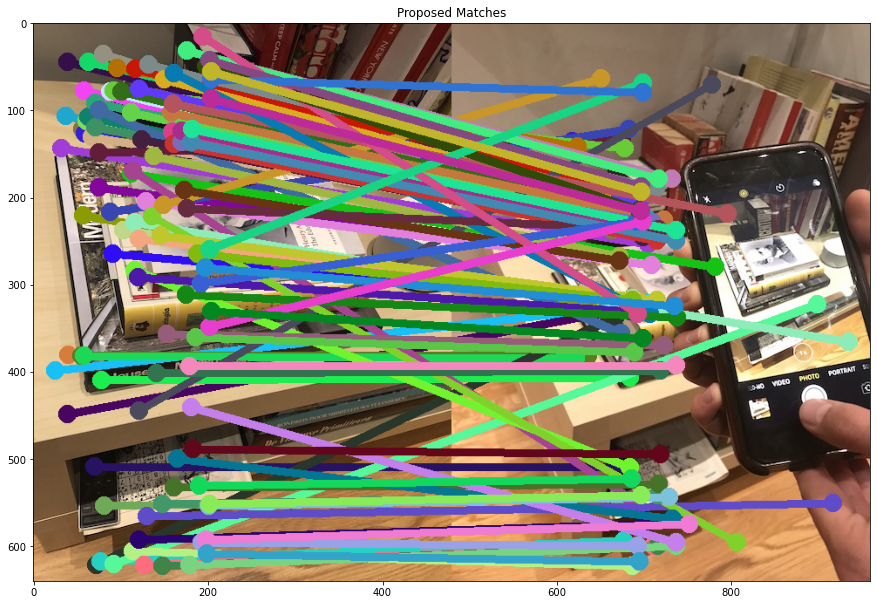

In [54]:
num_pts_to_visualize = 100
num_pts_total = min(pts1.shape[0], pts2.shape[0])
pts_to_viz = np.random.choice(np.arange(num_pts_total), num_pts_to_visualize, replace=False)

c2 = show_correspondence_lines(image1, image2,
                    pts1[:, 0], pts1[pts_to_viz, 1],
                    pts2[:, 0], pts2[pts_to_viz, 1],)
plt.figure(figsize=(15,20)) 
plt.title('Proposed Matches')
plt.imshow(c2)

In [55]:
from proj2_code.ransac import ransac_fundamental_matrix

F, matches_x0, matches_x1 = ransac_fundamental_matrix(pts1, pts2)
print('Fundamental matrix=', F)

[[244.05580139  31.74292374   1.        ]
 [112.6180954  208.290802     1.        ]
 [197.31884766 238.56791687   1.        ]
 [132.64128113 380.52282715   1.        ]
 [181.27688599 500.15893555   1.        ]
 [241.46936035 112.01385498   1.        ]
 [474.95031738 470.53723145   1.        ]
 [245.10826111  91.56732941   1.        ]
 [ 92.99705505 605.4710083    1.        ]]
9
[[244.05580139  31.74292374   1.        ]
 [112.6180954  208.290802     1.        ]
 [197.31884766 238.56791687   1.        ]
 [132.64128113 380.52282715   1.        ]
 [181.27688599 500.15893555   1.        ]
 [241.46936035 112.01385498   1.        ]
 [474.95031738 470.53723145   1.        ]
 [245.10826111  91.56732941   1.        ]
 [ 92.99705505 605.4710083    1.        ]]
9
[[244.05580139  31.74292374   1.        ]
 [112.6180954  208.290802     1.        ]
 [197.31884766 238.56791687   1.        ]
 [132.64128113 380.52282715   1.        ]
 [181.27688599 500.15893555   1.        ]
 [241.46936035 112.01385498 

 [ 92.99705505 605.4710083    1.        ]]
9
[[244.05580139  31.74292374   1.        ]
 [112.6180954  208.290802     1.        ]
 [197.31884766 238.56791687   1.        ]
 [132.64128113 380.52282715   1.        ]
 [181.27688599 500.15893555   1.        ]
 [241.46936035 112.01385498   1.        ]
 [474.95031738 470.53723145   1.        ]
 [245.10826111  91.56732941   1.        ]
 [ 92.99705505 605.4710083    1.        ]]
9
[[244.05580139  31.74292374   1.        ]
 [112.6180954  208.290802     1.        ]
 [197.31884766 238.56791687   1.        ]
 [132.64128113 380.52282715   1.        ]
 [181.27688599 500.15893555   1.        ]
 [241.46936035 112.01385498   1.        ]
 [474.95031738 470.53723145   1.        ]
 [245.10826111  91.56732941   1.        ]
 [ 92.99705505 605.4710083    1.        ]]
9
[[244.05580139  31.74292374   1.        ]
 [112.6180954  208.290802     1.        ]
 [197.31884766 238.56791687   1.        ]
 [132.64128113 380.52282715   1.        ]
 [181.27688599 500.158935

[[225.21354675  64.37179565   1.        ]
 [298.63604736 136.68461609   1.        ]
 [311.19396973 475.47061157   1.        ]
 [170.42842102 188.53070068   1.        ]
 [161.90905762 237.60409546   1.        ]
 [ 40.42342377 604.0814209    1.        ]
 [159.44830322 381.14437866   1.        ]
 [238.55882263 106.94650269   1.        ]
 [298.63604736 136.68461609   1.        ]]
9
[[225.21354675  64.37179565   1.        ]
 [298.63604736 136.68461609   1.        ]
 [311.19396973 475.47061157   1.        ]
 [170.42842102 188.53070068   1.        ]
 [161.90905762 237.60409546   1.        ]
 [ 40.42342377 604.0814209    1.        ]
 [159.44830322 381.14437866   1.        ]
 [238.55882263 106.94650269   1.        ]
 [298.63604736 136.68461609   1.        ]]
9
[[225.21354675  64.37179565   1.        ]
 [298.63604736 136.68461609   1.        ]
 [311.19396973 475.47061157   1.        ]
 [170.42842102 188.53070068   1.        ]
 [161.90905762 237.60409546   1.        ]
 [ 40.42342377 604.0814209  

[[ 59.10093307 154.60522461   1.        ]
 [235.66618347 126.80944824   1.        ]
 [315.09075928 622.75592041   1.        ]
 [ 57.84542084 262.97399902   1.        ]
 [204.15478516 102.53897858   1.        ]
 [ 81.9716568  319.0423584    1.        ]
 [298.63604736 136.68461609   1.        ]
 [116.90233612 242.3611145    1.        ]
 [202.72761536  52.30931854   1.        ]]
9
[[ 59.10093307 154.60522461   1.        ]
 [235.66618347 126.80944824   1.        ]
 [315.09075928 622.75592041   1.        ]
 [ 57.84542084 262.97399902   1.        ]
 [204.15478516 102.53897858   1.        ]
 [ 81.9716568  319.0423584    1.        ]
 [298.63604736 136.68461609   1.        ]
 [116.90233612 242.3611145    1.        ]
 [202.72761536  52.30931854   1.        ]]
9
[[ 59.10093307 154.60522461   1.        ]
 [235.66618347 126.80944824   1.        ]
 [315.09075928 622.75592041   1.        ]
 [ 57.84542084 262.97399902   1.        ]
 [204.15478516 102.53897858   1.        ]
 [ 81.9716568  319.0423584  

[[121.9151535  532.14178467   1.        ]
 [176.92140198 488.83242798   1.        ]
 [ 32.48091125 263.78210449   1.        ]
 [241.46936035 112.01385498   1.        ]
 [ 92.89364624 216.55897522   1.        ]
 [138.09962463 398.550354     1.        ]
 [197.31884766 238.56791687   1.        ]
 [202.72761536  52.30931854   1.        ]
 [309.47705078 221.0335083    1.        ]]
9
[[121.9151535  532.14178467   1.        ]
 [176.92140198 488.83242798   1.        ]
 [ 32.48091125 263.78210449   1.        ]
 [241.46936035 112.01385498   1.        ]
 [ 92.89364624 216.55897522   1.        ]
 [138.09962463 398.550354     1.        ]
 [197.31884766 238.56791687   1.        ]
 [202.72761536  52.30931854   1.        ]
 [309.47705078 221.0335083    1.        ]]
9
[[121.9151535  532.14178467   1.        ]
 [176.92140198 488.83242798   1.        ]
 [ 32.48091125 263.78210449   1.        ]
 [241.46936035 112.01385498   1.        ]
 [ 92.89364624 216.55897522   1.        ]
 [138.09962463 398.550354   

[[176.97689819 204.16433716   1.        ]
 [153.01203918 524.11444092   1.        ]
 [ 39.18016815 312.75823975   1.        ]
 [202.35664368 121.0012207    1.        ]
 [252.88728333  55.94713593   1.        ]
 [396.88491821 602.27514648   1.        ]
 [192.0645752  138.17347717   1.        ]
 [165.88517761 530.32800293   1.        ]
 [316.10754395  49.05254745   1.        ]]
9
[[176.97689819 204.16433716   1.        ]
 [153.01203918 524.11444092   1.        ]
 [ 39.18016815 312.75823975   1.        ]
 [202.35664368 121.0012207    1.        ]
 [252.88728333  55.94713593   1.        ]
 [396.88491821 602.27514648   1.        ]
 [192.0645752  138.17347717   1.        ]
 [165.88517761 530.32800293   1.        ]
 [316.10754395  49.05254745   1.        ]]
9
[[176.97689819 204.16433716   1.        ]
 [153.01203918 524.11444092   1.        ]
 [ 39.18016815 312.75823975   1.        ]
 [202.35664368 121.0012207    1.        ]
 [252.88728333  55.94713593   1.        ]
 [396.88491821 602.27514648 

[[146.2179718  516.93695068   1.        ]
 [ 58.2983284  165.97567749   1.        ]
 [ 75.46218872 553.41070557   1.        ]
 [138.09962463 398.550354     1.        ]
 [159.44830322 381.14437866   1.        ]
 [230.03132629 169.69706726   1.        ]
 [230.03132629 169.69706726   1.        ]
 [124.58863831 291.96466064   1.        ]
 [220.8110199   47.19935989   1.        ]]
9
[[146.2179718  516.93695068   1.        ]
 [ 58.2983284  165.97567749   1.        ]
 [ 75.46218872 553.41070557   1.        ]
 [138.09962463 398.550354     1.        ]
 [159.44830322 381.14437866   1.        ]
 [230.03132629 169.69706726   1.        ]
 [230.03132629 169.69706726   1.        ]
 [124.58863831 291.96466064   1.        ]
 [220.8110199   47.19935989   1.        ]]
9
[[146.2179718  516.93695068   1.        ]
 [ 58.2983284  165.97567749   1.        ]
 [ 75.46218872 553.41070557   1.        ]
 [138.09962463 398.550354     1.        ]
 [159.44830322 381.14437866   1.        ]
 [230.03132629 169.69706726 

[[204.99871826 499.97988892   1.        ]
 [411.77978516 595.09606934   1.        ]
 [194.64175415 107.89467621   1.        ]
 [327.23168945 440.22021484   1.        ]
 [ 39.18016815 312.75823975   1.        ]
 [315.09075928 622.75592041   1.        ]
 [234.21881104 123.83209991   1.        ]
 [248.66653442  35.03266907   1.        ]
 [474.95031738 470.53723145   1.        ]]
9
[[204.99871826 499.97988892   1.        ]
 [411.77978516 595.09606934   1.        ]
 [194.64175415 107.89467621   1.        ]
 [327.23168945 440.22021484   1.        ]
 [ 39.18016815 312.75823975   1.        ]
 [315.09075928 622.75592041   1.        ]
 [234.21881104 123.83209991   1.        ]
 [248.66653442  35.03266907   1.        ]
 [474.95031738 470.53723145   1.        ]]
9
[[204.99871826 499.97988892   1.        ]
 [411.77978516 595.09606934   1.        ]
 [194.64175415 107.89467621   1.        ]
 [327.23168945 440.22021484   1.        ]
 [ 39.18016815 312.75823975   1.        ]
 [315.09075928 622.75592041 

 [103.30618286 525.1583252    1.        ]]
9
[[ 88.61845398 551.14849854   1.        ]
 [158.13154602 356.98571777   1.        ]
 [127.04646301 381.46017456   1.        ]
 [212.24836731 152.75395203   1.        ]
 [352.57531738 592.19940186   1.        ]
 [325.21606445 621.33465576   1.        ]
 [129.21438599 344.83288574   1.        ]
 [120.07807159 154.46034241   1.        ]
 [103.30618286 525.1583252    1.        ]]
9
[[ 88.61845398 551.14849854   1.        ]
 [158.13154602 356.98571777   1.        ]
 [127.04646301 381.46017456   1.        ]
 [212.24836731 152.75395203   1.        ]
 [352.57531738 592.19940186   1.        ]
 [325.21606445 621.33465576   1.        ]
 [129.21438599 344.83288574   1.        ]
 [120.07807159 154.46034241   1.        ]
 [103.30618286 525.1583252    1.        ]]
9
[[ 88.61845398 551.14849854   1.        ]
 [158.13154602 356.98571777   1.        ]
 [127.04646301 381.46017456   1.        ]
 [212.24836731 152.75395203   1.        ]
 [352.57531738 592.199401

[[ 88.61845398 551.14849854   1.        ]
 [158.13154602 356.98571777   1.        ]
 [127.04646301 381.46017456   1.        ]
 [212.24836731 152.75395203   1.        ]
 [352.57531738 592.19940186   1.        ]
 [325.21606445 621.33465576   1.        ]
 [129.21438599 344.83288574   1.        ]
 [120.07807159 154.46034241   1.        ]
 [103.30618286 525.1583252    1.        ]]
9
[[ 88.61845398 551.14849854   1.        ]
 [158.13154602 356.98571777   1.        ]
 [127.04646301 381.46017456   1.        ]
 [212.24836731 152.75395203   1.        ]
 [352.57531738 592.19940186   1.        ]
 [325.21606445 621.33465576   1.        ]
 [129.21438599 344.83288574   1.        ]
 [120.07807159 154.46034241   1.        ]
 [103.30618286 525.1583252    1.        ]]
9
[[ 25.00209808 201.99337769   1.        ]
 [ 32.48091125 263.78210449   1.        ]
 [ 37.01263809 298.65594482   1.        ]
 [ 39.18016815 312.75823975   1.        ]
 [ 39.5221405  605.10235596   1.        ]
 [ 40.42342377 604.0814209  

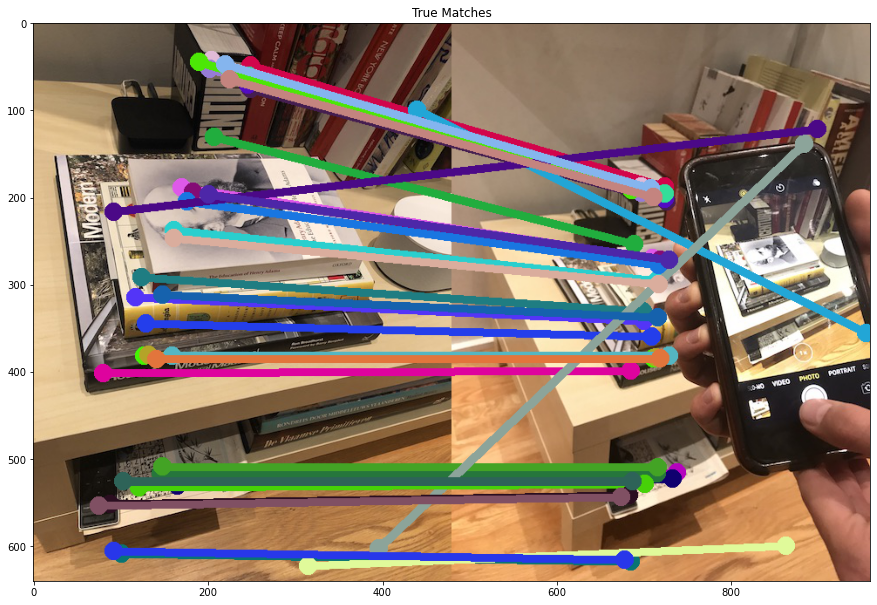

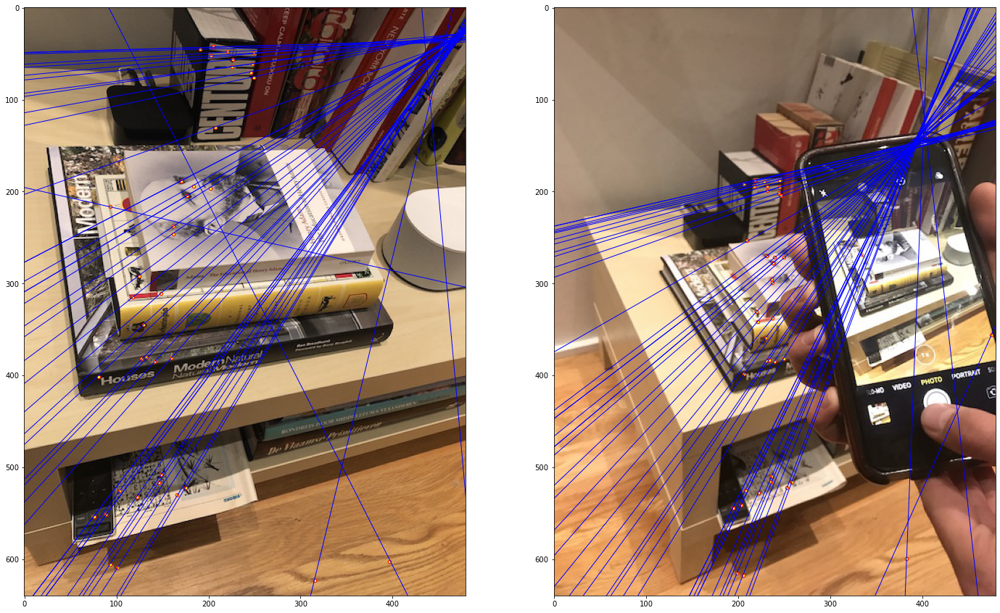

In [56]:
from proj2_code.utils import draw_epipolar_lines
# Draw the epipolar lines on the images and corresponding matches

num_pts_to_visualize = min(50, matches_x0.shape[0])
num_pts_total = matches_x0.shape[0]
pts_to_viz = np.random.choice(np.arange(num_pts_total), num_pts_to_visualize, replace=False)

match_image = show_correspondence_lines(image1, image2,
                                   matches_x0[pts_to_viz, 0], matches_x0[pts_to_viz, 1],
                                   matches_x1[pts_to_viz, 0], matches_x1[pts_to_viz, 1])
plt.figure(figsize=(15,20))
plt.title('True Matches')
plt.imshow(match_image)


draw_epipolar_lines(F, image1, image2, matches_x0, matches_x1)

**TODO:** Paste these three images on slide 13 and slide 14.

# Part EC1: Pose recovery from the fundamental matrix

## Part EC1.1 Recover essential matrix from fundamental matrix
Given the fundamental matrix, we can use the camera intrinsics to recover the essential matrix. Refer to the writeup/lecture slides for more details and the final equation.

For sake of simplicity, we will use the same calibration matrix for both the cameras. We will reuse the fundamental matrix computed in the previous part

**TODO:** complete `recover_E_from_F` in `recover_rot_translation.py`

In [57]:
# defining the camera intrinsic matrix
K = np.array([[600, 0, 240],
              [0, 600, 320],
              [0, 0, 1]
             ])

from proj2_code.recover_rot_translation import recover_E_from_F

E = recover_E_from_F(F, K)

print('Recovered essential matrix = ', E)

Recovered essential matrix =  [[-159.85550841 -477.90670693 -114.93748623]
 [ 426.09591922 -108.06827814 -142.18618657]
 [ 235.80482007  131.43133666  -24.55524804]]


In [58]:
from proj2_unit_tests.test_essential_matrix_decomposition import TestEssentialMatrixDecomposition

test_essential_matrix = TestEssentialMatrixDecomposition()
test_essential_matrix.setUp()
print("test_recover_E_from_F(): " + verify(test_essential_matrix.test_recover_E_from_F))

test_recover_E_from_F(): "Correct"


## Part EC1.2 Recover relative rotation and translation between camera poses


We will now recover relative rotation and translation direction between the two camera from the essential matrix. Please refer to Section 9.6.2 in the book for details and formulas

**TODO:** Complete `recover_rot_translation_from_E` in `recover_rot_translation.py`

In [59]:
from proj2_code.recover_rot_translation import recover_rot_translation_from_E

R1, R2, t = recover_rot_translation_from_E(E)

print('Rotation candidate #1 = ', R1)
print('Rotation candidate #2 = ', R2)
print('translation (scale and sign ambiguous) = ', t)

[[-159.85550841 -477.90670693 -114.93748623]
 [ 426.09591922 -108.06827814 -142.18618657]
 [ 235.80482007  131.43133666  -24.55524804]]
Rotation candidate #1 =  None
Rotation candidate #2 =  None
translation (scale and sign ambiguous) =  None


In [60]:
from proj2_unit_tests.test_essential_matrix_decomposition import TestEssentialMatrixDecomposition

test_essential_matrix = TestEssentialMatrixDecomposition()
test_essential_matrix.setUp()
print("test_recover_rot_translation_from_E(): " + verify(test_essential_matrix.test_recover_rot_translation_from_E))

[[1 0 0]
 [0 1 0]
 [0 0 1]]


TypeError: ufunc 'isfinite' not supported for the input types, and the inputs could not be safely coerced to any supported types according to the casting rule ''safe''

# Submission

That's it for this problem set. Please refer to the pdf for instructions about re-running all the unit tests and submitting the code and report.